In [46]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/sea-animals-image-dataste/Penguin/13441017033_5f20afed5c_o.jpg
/kaggle/input/sea-animals-image-dataste/Penguin/6814743888_d76f64e5e5_o.jpg
/kaggle/input/sea-animals-image-dataste/Penguin/7678547704_88ee08ec1d_b.jpg
/kaggle/input/sea-animals-image-dataste/Penguin/8474798677_0abda01a4a_o.jpg
/kaggle/input/sea-animals-image-dataste/Penguin/32902414928_2e8353fa26_o.jpg
/kaggle/input/sea-animals-image-dataste/Penguin/15504936167_e35ed3aff4_o.jpg
/kaggle/input/sea-animals-image-dataste/Penguin/7034434541_5ce97baae9_b.jpg
/kaggle/input/sea-animals-image-dataste/Penguin/5046498528_ce14576cc5_b.jpg
/kaggle/input/sea-animals-image-dataste/Penguin/8743767793_db72c2194c_b.jpg
/kaggle/input/sea-animals-image-dataste/Penguin/15662693510_45f2cba841_o.jpg
/kaggle/input/sea-animals-image-dataste/Penguin/8140231806_667fcddb19_o.jpg
/kaggle/input/sea-animals-image-dataste/Penguin/8265500033_50f71f9aa8_o.jpg
/kaggle/input/sea-animals-image-dataste/Penguin/25979744960_881d0aed86_b.jpg
/kaggle

# Library Imports

In [47]:
# General Utilities
import time
import os
import sys
import random
from collections import Counter

In [48]:
# Numerical Computation & Visualization
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [49]:
# Install pennylane
!pip install pennylane

In [50]:
# Quantum Machine Learning
import pennylane as qml

In [51]:
# PyTorch: Deep Learning Framework
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Subset, random_split
from torch.cuda.amp import autocast, GradScaler

In [52]:
# Torchvision: Dataset & Model Utilities
import torchvision.transforms as transforms
import torchvision.datasets as datasets
from torchvision import models
from torchvision.models import (
    ResNet50_Weights,
    ResNet34_Weights,
    ResNet101_Weights,
    DenseNet121_Weights,
)

In [53]:
# Scikit-learn: Evaluation Metrics
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report

# Basic Setup & Hyperparameters

In [54]:
# === Configuration ===
SEED = 42
IMAGE_SIZE = 224
BATCH_SIZE = 32
NUM_WORKERS = 4
N_QUBITS = 8
LEARNING_RATE = 0.00002
WEIGHT_DECAY = 5e-5
LR_FACTOR = 0.2
LR_PATIENCE = 8
NUM_EPOCHS = 30
VALIDATION_SPLIT = 0.2
TEST_SPLIT = 0.2
UNDERSAMPLE_TURTLE_TORTOISE = True
DATA_DIR = "/kaggle/input/sea-animals-image-dataste"

# Reproducibility Controls

In [55]:
qml.numpy.random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
random.seed(SEED)
if torch.cuda.is_available():
    torch.cuda.manual_seed_all(SEED)
os.environ['NCCL_DEBUG'] = 'INFO'

# Device Configuration

In [56]:
if torch.cuda.is_available():
    device = torch.device("cuda")
    num_gpus = torch.cuda.device_count()
    print(f"\n💻 Using device: {device} ({num_gpus} GPU(s))")
    if num_gpus > 1:
        torch.cuda.set_device(0)
        print(f"Setting default CUDA device to index 0.")
else:
    device = torch.device("cpu")
    num_gpus = 0
    print(f"\n💻 Using device: {device} (CPU)")


💻 Using device: cuda (2 GPU(s))
Setting default CUDA device to index 0.


# Data Transformations

In [57]:
transform_train = transforms.Compose(
    [
        transforms.Resize((IMAGE_SIZE, IMAGE_SIZE)),
        transforms.RandomHorizontalFlip(p=0.3),
        transforms.RandomRotation(degrees=8),
        transforms.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1, hue=0.03),
        transforms.RandomAffine(degrees=0, translate=(0.02, 0.02), scale=(0.98, 1.02)),
        transforms.RandomGrayscale(p=0.03),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
        transforms.RandomErasing(p=0.2, scale=(0.02, 0.15), ratio=(0.3, 3.3)),
    ]
)

transform_val = transforms.Compose(
    [
        transforms.Resize((IMAGE_SIZE, IMAGE_SIZE)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ]
)

transform_test = transforms.Compose(
    [
        transforms.Resize((IMAGE_SIZE, IMAGE_SIZE)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ]
)

# Dataset Loading & Summary

📂 Classes: ['Clams', 'Corals', 'Crabs', 'Dolphin', 'Eel', 'Fish', 'Jelly Fish', 'Lobster', 'Nudibranchs', 'Octopus', 'Otter', 'Penguin', 'Puffers', 'Sea Rays', 'Sea Urchins', 'Seahorse', 'Seal', 'Sharks', 'Shrimp', 'Squid', 'Starfish', 'Turtle_Tortoise', 'Whale']
📊 Number of classes: 23
🖼️ Total number of images: 13711

🔍 Dataset Description:
  - Class 'Clams': 497 images
  - Class 'Corals': 500 images
  - Class 'Crabs': 499 images
  - Class 'Dolphin': 782 images
  - Class 'Eel': 497 images
  - Class 'Fish': 494 images
  - Class 'Jelly Fish': 845 images
  - Class 'Lobster': 499 images
  - Class 'Nudibranchs': 500 images
  - Class 'Octopus': 562 images
  - Class 'Otter': 500 images
  - Class 'Penguin': 482 images
  - Class 'Puffers': 531 images
  - Class 'Sea Rays': 517 images
  - Class 'Sea Urchins': 579 images
  - Class 'Seahorse': 478 images
  - Class 'Seal': 414 images
  - Class 'Sharks': 590 images
  - Class 'Shrimp': 488 images
  - Class 'Squid': 483 images
  - Class 'Starfish': 4

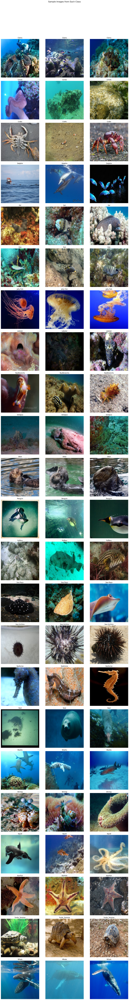

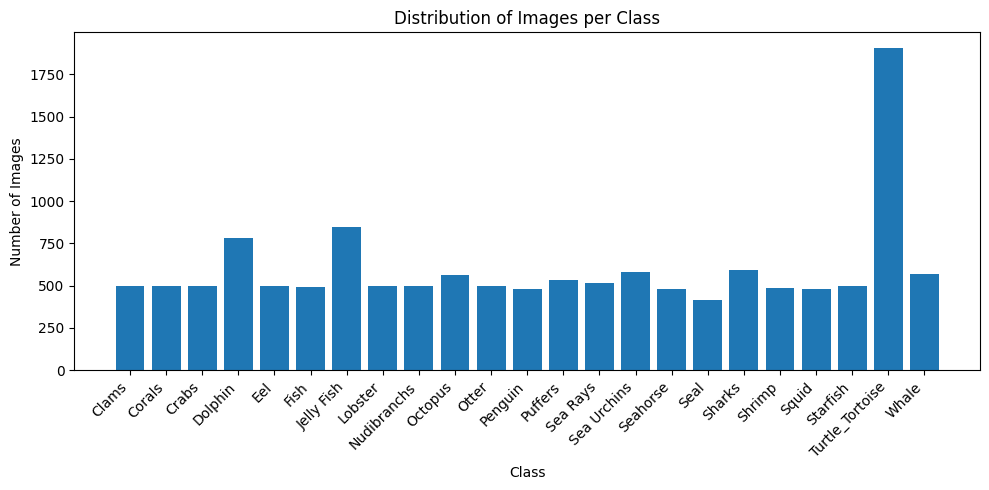

In [58]:
transform_initial = transforms.Compose([transforms.Resize((IMAGE_SIZE, IMAGE_SIZE)), transforms.ToTensor()])
try:
    full_dataset = datasets.ImageFolder(root=DATA_DIR, transform=transform_initial)
    classes = full_dataset.classes
    targets = np.array(full_dataset.targets)
    num_classes = len(classes)

    print("📂 Classes:", classes)
    print("📊 Number of classes:", num_classes)
    print("🖼️ Total number of images:", len(full_dataset.samples))
    print("\n🔍 Dataset Description:")
    class_counts_dict = Counter(full_dataset.targets)
    for i, class_name in enumerate(classes):
        num_samples = class_counts_dict[i]
        print(f"  - Class '{class_name}': {num_samples} images")

    # --- Displaying Sample Images ---
    num_samples_to_display = 3
    fig, axes = plt.subplots(num_classes, num_samples_to_display, figsize=(15, 5 * num_classes))
    fig.suptitle("Sample Images from Each Class", fontsize=16)
    for i, class_name in enumerate(classes):
        indices = np.where(targets == i)[0]
        random_indices = np.random.choice(indices, min(num_samples_to_display, len(indices)), replace=False)
        for j, img_index in enumerate(random_indices):
            image, _ = full_dataset[img_index]
            axes[i, j].imshow(image.permute(1, 2, 0))
            axes[i, j].set_title(f"{class_name}")
            axes[i, j].axis('off')
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

    # --- Bar Plot of Class Distribution ---
    plt.figure(figsize=(10, 5))
    plt.bar(classes, list(class_counts_dict.values()))
    plt.xlabel("Class")
    plt.ylabel("Number of Images")
    plt.title("Distribution of Images per Class")
    plt.xticks(rotation=45, ha="right")
    plt.tight_layout()
    plt.show()

except Exception as e:
    print(f"⚠ Error loading dataset: {e}")
    sys.exit(1)

# Dataset Splitting & Class Imbalance Handling

In [59]:
# === Data Splitting and Handling Imbalance ===
train_dataset, val_dataset, test_dataset = None, None, None
if UNDERSAMPLE_TURTLE_TORTOISE and 'Turtle_Tortoise' in classes:
    turtle_tortoise_index = classes.index('Turtle_Tortoise')
    turtle_tortoise_indices = np.where(targets == turtle_tortoise_index)[0]
    other_indices = np.where(targets != turtle_tortoise_index)[0]
    target_turtle_count = int(np.median(list(class_counts_dict.values())))
    undersampled_turtle_indices = np.random.choice(turtle_tortoise_indices, size=target_turtle_count, replace=False)
    balanced_indices = np.concatenate([other_indices, undersampled_turtle_indices])
    balanced_targets = targets[balanced_indices]

    train_idx, val_test_idx = train_test_split(
        balanced_indices, test_size=VALIDATION_SPLIT + TEST_SPLIT, stratify=balanced_targets, random_state=SEED
    )
    val_test_targets = balanced_targets[np.isin(balanced_indices, val_test_idx)]
    val_idx, test_idx = train_test_split(
        val_test_idx, test_size=TEST_SPLIT / (VALIDATION_SPLIT + TEST_SPLIT), stratify=val_test_targets, random_state=SEED
    )
    train_dataset = Subset(full_dataset, train_idx)
    val_dataset = Subset(full_dataset, val_idx)
    test_dataset = Subset(full_dataset, test_idx)
    print(f"Train set size: {len(train_dataset)}")
    print(f"Val set size: {len(val_dataset)}")
    print(f"Test set size: {len(test_dataset)}")
else:
    train_size = int(len(full_dataset) * (1 - VALIDATION_SPLIT - TEST_SPLIT))
    val_size = int(len(full_dataset) * VALIDATION_SPLIT)
    test_size = len(full_dataset) - train_size - val_size
    train_dataset, val_dataset, test_dataset = random_split(
        full_dataset, [train_size, val_size, test_size], generator=torch.Generator().manual_seed(SEED)
    )

if train_dataset and val_dataset and test_dataset:
    train_dataset.dataset.transform = transform_train
    val_dataset.dataset.transform = transform_val
    test_dataset.dataset.transform = transform_test

    # === Data Loaders ===
    train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=NUM_WORKERS, pin_memory=True)
    val_loader = DataLoader(val_dataset, batch_size=2 * BATCH_SIZE, shuffle=False, num_workers=NUM_WORKERS, pin_memory=True)
    test_loader = DataLoader(test_dataset, batch_size=2 * BATCH_SIZE, shuffle=False, num_workers=NUM_WORKERS, pin_memory=True)
else:
    print("Error: Datasets not properly created.")
    sys.exit(1)

Train set size: 7384
Val set size: 2462
Test set size: 2462


# Quantum Layer Setup

In [60]:
# === Quantum Layer Setup ===
dev = qml.device("default.qubit", wires=N_QUBITS)

@qml.qnode(dev)
def quantum_layer(inputs):
    """Quantum layer circuit."""
    for i in range(N_QUBITS):
        qml.RX(inputs[i], wires=i)
    for i in range(0, N_QUBITS - 1, 2):
        qml.CNOT(wires=[i, i + 1])
    return tuple(qml.expval(qml.PauliZ(i)) for i in range(N_QUBITS))

# Hybrid Quantum-Classical Model: HybridQCNN

In [75]:
# === Hybrid Quantum-Classical Model ===
class HybridQCNN(nn.Module):
    """Hybrid quantum-classical convolutional neural network."""

    def __init__(self, backbone, num_classes, n_qubits=N_QUBITS):
        super().__init__()
        in_features = self._get_in_features(backbone)
        self.feature_extractor = self._remove_classifier(backbone)
        self.n_qubits = n_qubits
        self.fc1 = nn.Sequential(
            nn.Linear(in_features + n_qubits, 256),
            nn.BatchNorm1d(256),
            nn.ReLU(),
            nn.Dropout(0.7),
            nn.Linear(256, 128),
            nn.BatchNorm1d(128),
            nn.ReLU(),
            nn.Dropout(0.7),
        )
        self.fc2 = nn.Linear(128, num_classes)

    def _get_in_features(self, model):
        if hasattr(model, "fc"):
            return model.fc.in_features
        elif hasattr(model, "classifier") and hasattr(model.classifier, "in_features"):
            return model.classifier.in_features
        elif hasattr(model, "classifier") and isinstance(model.classifier, nn.Sequential):
            for layer in reversed(model.classifier):
                if isinstance(layer, nn.Linear):
                    return layer.in_features
        raise ValueError("Cannot find the final fully connected layer for feature size.")

    def _remove_classifier(self, model):
        if hasattr(model, "fc"):
            model.fc = nn.Identity()
        elif hasattr(model, "classifier"):
            model.classifier = nn.Identity()
        return model

    def forward(self, x):
        x = self.feature_extractor(x)
        x = x.view(x.size(0), -1)
        q_feats = [quantum_layer(sample[:self.n_qubits].cpu().detach().numpy()) for sample in x]
        quantum_features = torch.tensor(q_feats, dtype=torch.float32).to(x.device)
        x = torch.cat((x, quantum_features), dim=1)
        x = self.fc1(x)
        x = self.fc2(x)
        return x

# Classical CNN Model

In [76]:
# === Classical CNN Model ===
class ClassicalCNN(nn.Module):
    """Classical convolutional neural network."""

    def __init__(self, backbone, num_classes):
        super().__init__()
        in_features = self._get_in_features(backbone)
        self.feature_extractor = self._remove_classifier(backbone)
        self.fc1 = nn.Sequential(
            nn.Linear(in_features, 256),
            nn.BatchNorm1d(256),
            nn.ReLU(),
            nn.Dropout(0.7),
            nn.Linear(256, 128),
            nn.BatchNorm1d(128),
            nn.ReLU(),
            nn.Dropout(0.7),
        )
        self.fc2 = nn.Linear(128, num_classes)

    def _get_in_features(self, model):
        if hasattr(model, "fc"):
            return model.fc.in_features
        elif hasattr(model, "classifier") and hasattr(model.classifier, "in_features"):
            return model.classifier.in_features
        elif hasattr(model, "classifier") and isinstance(model.classifier, nn.Sequential):
            for layer in reversed(model.classifier):
                if isinstance(layer, nn.Linear):
                    return layer.in_features
        raise ValueError("Cannot find the final fully connected layer for feature size.")

    def _remove_classifier(self, model):
        if hasattr(model, "fc"):
            model.fc = nn.Identity()
        elif hasattr(model, "classifier"):
            model.classifier = nn.Identity()
        return model

    def forward(self, x):
        x = self.feature_extractor(x)
        x = x.view(x.size(0), -1)
        x = self.fc1(x)
        x = self.fc2(x)
        return x

# Model Training Function

In [77]:
# === Model Training Function ===
def train_model(model, train_loader, val_loader, num_classes):
    """Trains the given model."""
    print(f"\n🚀 Training {model.__class__.__name__}...")
    model.to(device)
    if num_gpus > 1:
        print("Using DataParallel for multi-GPU training.")
        model = nn.DataParallel(model)

    # --- Calculate class weights ---
    class_counts_train = Counter()
    for _, labels in train_loader:
        class_counts_train.update(labels.cpu().numpy())
    total_samples_train = sum(class_counts_train.values())
    class_weights = torch.ones(num_classes, dtype=torch.float).to(device)
    if total_samples_train > 0:
        sorted_weights = [total_samples_train / (num_classes * class_counts_train.get(i, 1e-6)) for i in range(num_classes)]
        class_weights = torch.tensor(sorted_weights, dtype=torch.float).to(device)

    criterion = nn.CrossEntropyLoss(weight=class_weights)
    optimizer = optim.AdamW(model.parameters(), lr=LEARNING_RATE, weight_decay=WEIGHT_DECAY)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
        optimizer, mode='min', factor=LR_FACTOR, patience=LR_PATIENCE, verbose=True
    )

    train_losses, val_losses = [], []
    train_accuracies, val_accuracies = [], []
    all_val_preds, all_val_labels = [], []
    all_val_images = []

    scaler = GradScaler()
    for epoch in range(NUM_EPOCHS):
        model.train()
        total_loss, correct, total = 0.0, 0, 0
        for images, labels in train_loader:
            images, labels = images.to(device), labels.to(device)
            optimizer.zero_grad()
            with autocast():
                outputs = model(images)
                loss = criterion(outputs, labels)
            scaler.scale(loss).backward()
            scaler.step(optimizer)
            scaler.update()

            total_loss += loss.item()
            _, predicted = torch.max(outputs, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

        train_loss = total_loss / len(train_loader)
        train_accuracy = 100 * correct / total
        train_losses.append(train_loss)
        train_accuracies.append(train_accuracy)

        model.eval()
        val_loss, val_correct, val_total = 0.0, 0, 0
        current_val_preds, current_val_labels = [], []
        current_val_images = []

        with torch.no_grad():
            for images, labels in val_loader:
                images_cpu = images.cpu()
                images, labels = images.to(device), labels.to(device)
                outputs = model(images)
                loss = criterion(outputs, labels)
                val_loss += loss.item()

                _, predicted = torch.max(outputs, 1)
                val_total += labels.size(0)
                val_correct += (predicted == labels).sum().item()

                current_val_preds.extend(predicted.cpu().numpy())
                current_val_labels.extend(labels.cpu().numpy())
                current_val_images.extend(images_cpu.numpy())

        val_loss = val_loss / len(val_loader)
        val_accuracy = 100 * val_correct / val_total
        val_losses.append(val_loss)
        val_accuracies.append(val_accuracy)
        all_val_preds = current_val_preds
        all_val_labels = current_val_labels
        all_val_images = current_val_images

        print(
            f"Epoch {epoch + 1}/{NUM_EPOCHS}, "
            f"Train Loss: {train_loss:.4f}, Train Acc: {train_accuracy:.2f}%, "
            f"Val Loss: {val_loss:.4f}, Val Acc: {val_accuracy:.2f}%"
        )

        scheduler.step(val_loss)

    return (
        train_losses,
        train_accuracies,
        val_losses,
        val_accuracies,
        all_val_preds,
        all_val_labels,
        all_val_images
    )


# Model Testing Function

In [78]:
# === Model Testing Function ===
def test_model(model, test_loader, full_dataset_classes):
    """Tests the given model."""
    print("\n🔍 Testing started...")
    model.to(device)

    if num_gpus > 1:
        print("Using DataParallel for multi-GPU testing.")
        model = nn.DataParallel(model)

    model.eval()
    test_loss, test_correct, test_total = 0.0, 0, 0
    all_test_preds, all_test_labels = [], []
    all_test_images = []
    correct = 0
    criterion = nn.CrossEntropyLoss()

    with torch.no_grad():
        for images, labels in test_loader:
            images_cpu = images.cpu()
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            loss = criterion(outputs, labels)
            test_loss += loss.item()

            _, predicted = torch.max(outputs, 1)
            test_total += labels.size(0)
            correct += (predicted == labels).sum().item()

            all_test_preds.extend(predicted.cpu().numpy())
            all_test_labels.extend(labels.cpu().numpy())
            all_test_images.extend(images_cpu.numpy())

    test_accuracy = 100 * correct / test_total
    avg_test_loss = test_loss / len(test_loader)

    print(f"\n✅ Test Accuracy: {test_accuracy:.2f}%")
    print(f"📉 Test Loss: {avg_test_loss:.4f}")
    print("\n📊 Classification Report:\n")
    print(classification_report(all_test_labels, all_test_preds, target_names=full_dataset_classes))

    cm = confusion_matrix(all_test_labels, all_test_preds)
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=full_dataset_classes, yticklabels=full_dataset_classes)
    plt.title("Confusion Matrix")
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.tight_layout()
    plt.show()

    return all_test_preds, all_test_labels, test_accuracy, all_test_images

# Model Comparison and Metrics Plotting Functions

In [79]:
# === Model Comparison Plot ===
def plot_model_comparison(all_model_accuracies):
    """Plots and compares the validation accuracies of all models."""
    plt.figure(figsize=(10, 6))
    for model_name, accuracies in all_model_accuracies.items():
        plt.plot(
            range(1, len(accuracies) + 1), accuracies, label=f"{model_name}"
        )
    plt.xlabel("Epochs")
    plt.ylabel("Validation Accuracy (%)")
    plt.title("Model Comparison: Validation Accuracy Over Epochs")
    plt.legend()
    plt.grid(True)
    plt.show()

def plot_metrics(train_losses, val_losses, train_accuracies, val_accuracies, model_name):
    """Plots training and validation loss and accuracy."""
    epochs = range(1, len(train_losses) + 1)
    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    plt.plot(epochs, train_losses, 'r', label='Training loss')
    plt.plot(epochs, val_losses, 'b', label='Validation loss')
    plt.title(f'{model_name} Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(epochs, train_accuracies, 'r', label='Training accuracy')
    plt.plot(epochs, val_accuracies, 'b', label='Validation accuracy')
    plt.title(f'{model_name} Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy (%)')
    plt.legend()

    plt.tight_layout()
    plt.show()

def plot_confusion_matrix(labels, predictions, classes, model_name):
    """Plots the confusion matrix."""
    cm = confusion_matrix(labels, predictions)
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=classes, yticklabels=classes)
    plt.title(f'{model_name} Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.tight_layout()
    plt.show()

def print_classification_report(labels, predictions, classes, model_name):
    """Prints the classification report."""
    print(f"\n📊 Classification Report for {model_name}:\n")
    print(classification_report(labels, predictions, target_names=classes))

# === Visualization Functions (Updated for Clean Images) ===
def denormalize_image(tensor):
    """Denormalize image tensor using ImageNet stats"""
    mean = torch.tensor([0.485, 0.456, 0.406]).view(3, 1, 1).to(tensor.device)
    std = torch.tensor([0.229, 0.224, 0.225]).view(3, 1, 1).to(tensor.device)
    return tensor * std + mean

def display_predictions(images, true_labels, predicted_labels, classes, num_display=5):
    """Displays multiple sample images with true and predicted labels in a single horizontal row."""
    plt.figure(figsize=(15, 3))  # Adjust height as needed

    for i in range(min(num_display, len(images))):
        # Handle numpy arrays or tensors
        if isinstance(images[i], np.ndarray):
            img = torch.from_numpy(images[i])
        else:
            img = images[i]

        # Denormalize and convert to HWC format
        img = denormalize_image(img)
        img = img.cpu().numpy().transpose(1, 2, 0)
        img = np.clip(img, 0, 1)  # Ensure valid pixel range

        plt.subplot(1, num_display, i + 1)
        plt.imshow(img)
        plt.title(f"True: {classes[true_labels[i]]}\nPred: {classes[predicted_labels[i]]}", fontsize=8)
        plt.axis('off')

    plt.tight_layout()
    plt.show()

def display_dataset_images(dataset, classes, num_display=5):
    """Displays sample images from the dataset in a row."""
    plt.figure(figsize=(15, 3 * num_display))
    for i in range(min(num_display, len(dataset))):
        image, label = dataset[i]
        image = image.unsqueeze(0).to(device)
        image = denormalize_image(image).cpu().squeeze().numpy().transpose(1, 2, 0)
        image = np.clip(image, 0, 1)

        plt.subplot(1, num_display, i + 1)
        plt.imshow(image)
        plt.title(f"Class: {classes[label]}", fontsize=10)
        plt.axis('off')
    plt.tight_layout()
    plt.show()

# Model setup

In [80]:
# === Model Setup ===
def get_models(
    use_resnet34=True, use_resnet50=True, use_resnet101=True, use_densenet121=True
):
    """
    Returns a dictionary of models based on user-specified flags.
    """
    available_models = {}
    if use_resnet34:
        available_models["ResNet34 (Quantum)"] = models.resnet34(
            weights=ResNet34_Weights.DEFAULT
        )
        available_models["ResNet34 (Classical)"] = models.resnet34(
            weights=ResNet34_Weights.DEFAULT
        )
    if use_resnet50:
        available_models["ResNet50 (Quantum)"] = models.resnet50(
            weights=ResNet50_Weights.DEFAULT
        )
        available_models["ResNet50 (Classical)"] = models.resnet50(
            weights=ResNet50_Weights.DEFAULT
        )
    if use_resnet101:
        available_models["ResNet101 (Quantum)"] = models.resnet101(
            weights=ResNet101_Weights.DEFAULT
        )
        available_models["ResNet101 (Classical)"] = models.resnet101(
            weights=ResNet101_Weights.DEFAULT
        )
    if use_densenet121:
        available_models["DenseNet121 (Quantum)"] = models.densenet121(
            weights=DenseNet121_Weights.DEFAULT
        )
        available_models["DenseNet121 (Classical)"] = models.densenet121(
            weights=DenseNet121_Weights.DEFAULT
        )
    return available_models


# Main Function


--- Training and Testing ResNet34 (Quantum) ---

🚀 Training HybridQCNN...
Using DataParallel for multi-GPU training.


/tmp/ipykernel_31/2903460415.py:31: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()
/tmp/ipykernel_31/2903460415.py:38: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Epoch 1/30, Train Loss: 3.1603, Train Acc: 7.84%, Val Loss: 2.7235, Val Acc: 35.58%
Epoch 2/30, Train Loss: 2.8027, Train Acc: 19.98%, Val Loss: 2.3826, Val Acc: 51.22%
Epoch 3/30, Train Loss: 2.5627, Train Acc: 29.51%, Val Loss: 2.1670, Val Acc: 58.98%
Epoch 4/30, Train Loss: 2.3775, Train Acc: 37.85%, Val Loss: 1.9847, Val Acc: 65.39%
Epoch 5/30, Train Loss: 2.2360, Train Acc: 44.22%, Val Loss: 1.8108, Val Acc: 68.64%
Epoch 6/30, Train Loss: 2.0857, Train Acc: 51.86%, Val Loss: 1.7372, Val Acc: 72.06%
Epoch 7/30, Train Loss: 1.9635, Train Acc: 57.41%, Val Loss: 1.6044, Val Acc: 75.18%
Epoch 8/30, Train Loss: 1.8486, Train Acc: 61.90%, Val Loss: 1.5648, Val Acc: 76.20%
Epoch 9/30, Train Loss: 1.7052, Train Acc: 68.68%, Val Loss: 1.4084, Val Acc: 77.13%
Epoch 10/30, Train Loss: 1.5976, Train Acc: 72.62%, Val Loss: 1.3630, Val Acc: 78.88%
Epoch 11/30, Train Loss: 1.4754, Train Acc: 77.64%, Val Loss: 1.2923, Val Acc: 79.12%
Epoch 12/30, Train Loss: 1.3634, Train Acc: 81.12%, Val Loss: 1.

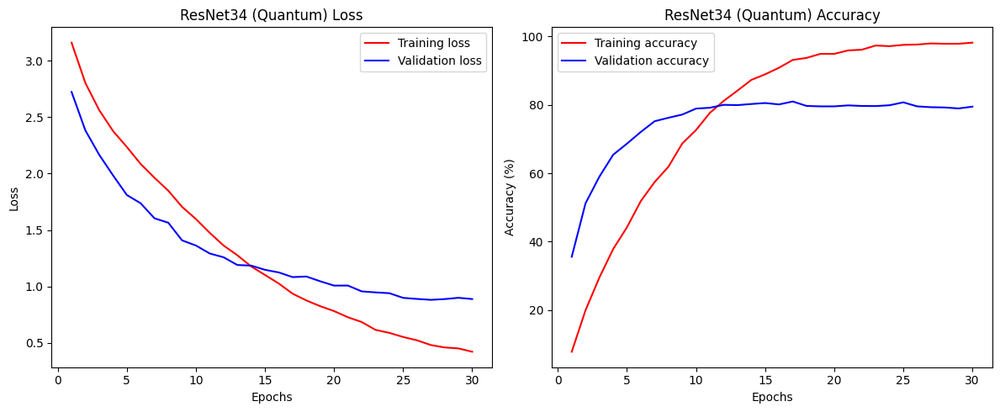

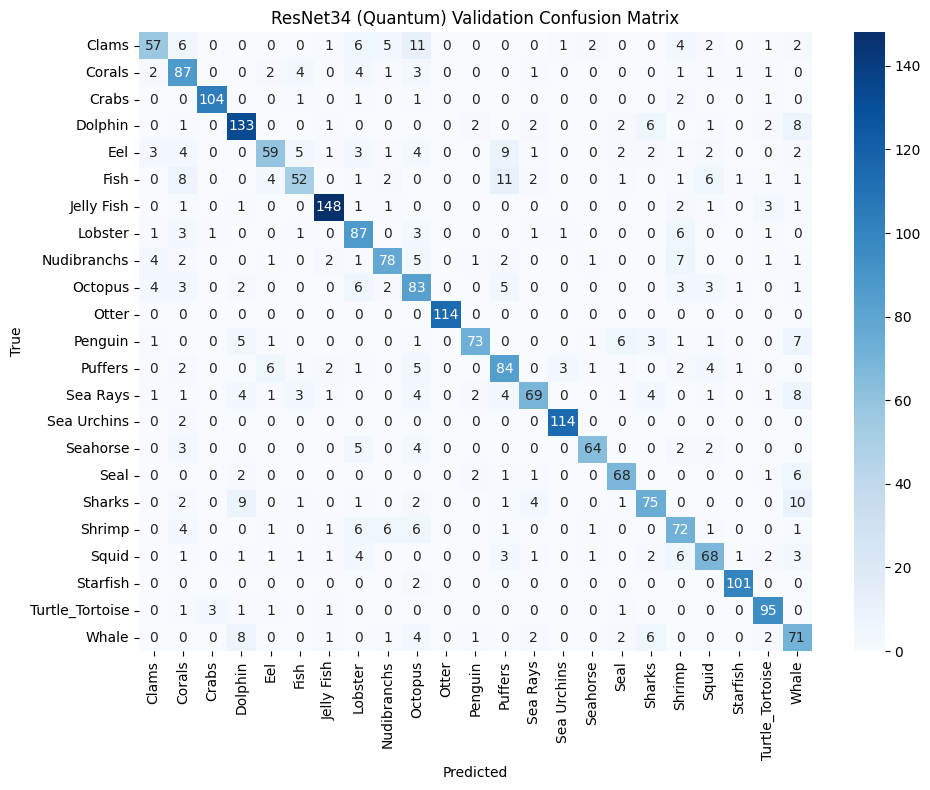


📊 Classification Report for ResNet34 (Quantum) Validation:

                 precision    recall  f1-score   support

          Clams       0.78      0.58      0.67        98
         Corals       0.66      0.81      0.73       108
          Crabs       0.96      0.95      0.95       110
        Dolphin       0.80      0.84      0.82       158
            Eel       0.77      0.60      0.67        99
           Fish       0.75      0.57      0.65        91
     Jelly Fish       0.93      0.93      0.93       159
        Lobster       0.69      0.83      0.75       105
    Nudibranchs       0.80      0.74      0.77       106
        Octopus       0.60      0.73      0.66       113
          Otter       1.00      1.00      1.00       114
        Penguin       0.90      0.73      0.81       100
        Puffers       0.69      0.74      0.72       113
       Sea Rays       0.82      0.66      0.73       105
    Sea Urchins       0.96      0.98      0.97       116
       Seahorse       0.90

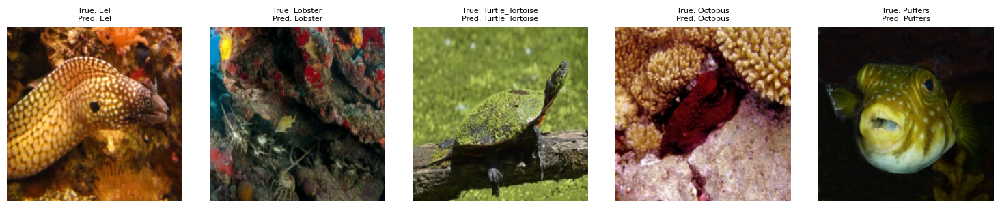


🔍 Testing started...
Using DataParallel for multi-GPU testing.

✅ Test Accuracy: 79.41%
📉 Test Loss: 0.8626

📊 Classification Report:

                 precision    recall  f1-score   support

          Clams       0.82      0.63      0.72       101
         Corals       0.54      0.80      0.64        92
          Crabs       0.90      0.94      0.92        90
        Dolphin       0.78      0.85      0.81       155
            Eel       0.73      0.62      0.67       100
           Fish       0.77      0.57      0.65       106
     Jelly Fish       0.96      0.92      0.94       179
        Lobster       0.65      0.73      0.69        95
    Nudibranchs       0.81      0.72      0.76        94
        Octopus       0.55      0.68      0.61       112
          Otter       0.97      1.00      0.98        86
        Penguin       0.93      0.76      0.84        93
        Puffers       0.76      0.79      0.78        99
       Sea Rays       0.81      0.70      0.75       102
    Sea 

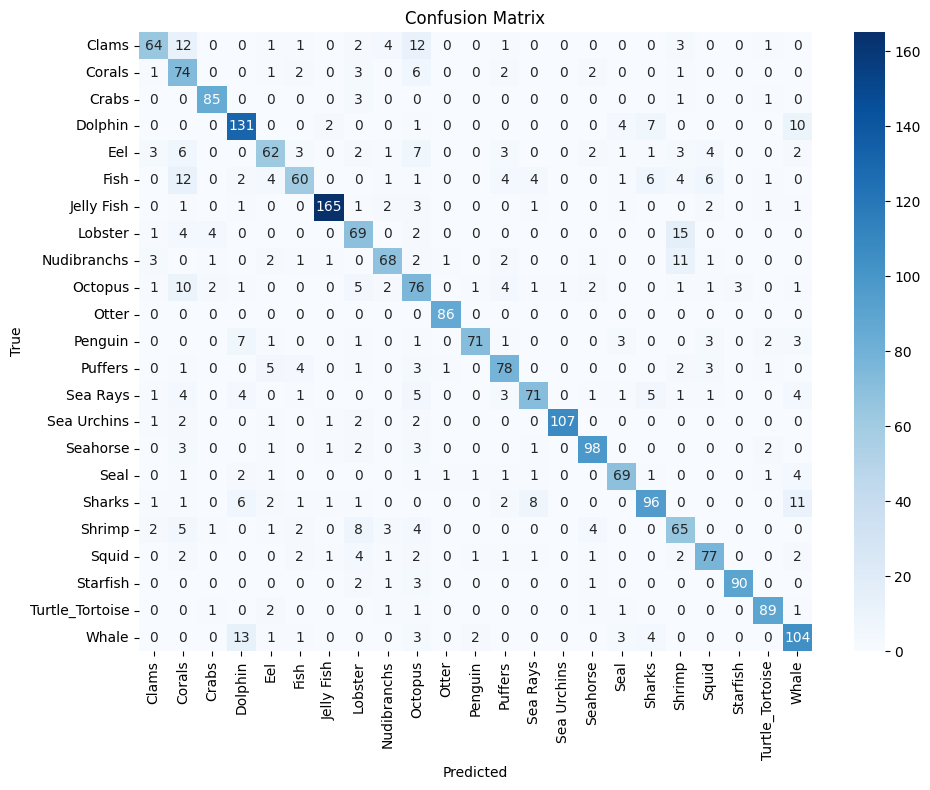

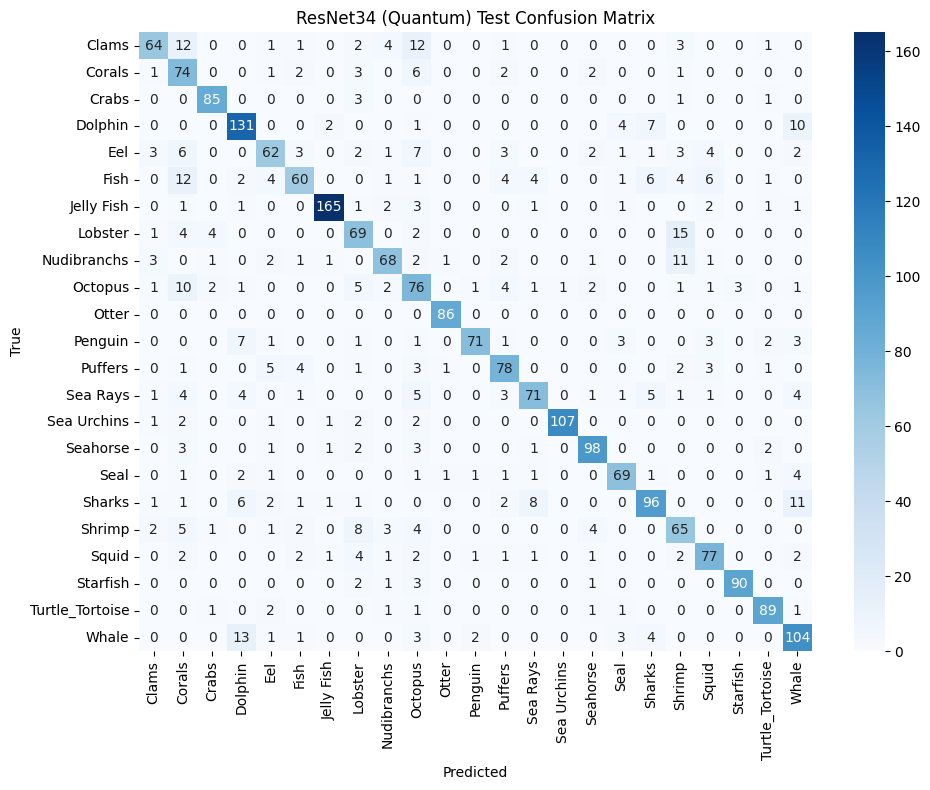


📊 Classification Report for ResNet34 (Quantum) Test:

                 precision    recall  f1-score   support

          Clams       0.82      0.63      0.72       101
         Corals       0.54      0.80      0.64        92
          Crabs       0.90      0.94      0.92        90
        Dolphin       0.78      0.85      0.81       155
            Eel       0.73      0.62      0.67       100
           Fish       0.77      0.57      0.65       106
     Jelly Fish       0.96      0.92      0.94       179
        Lobster       0.65      0.73      0.69        95
    Nudibranchs       0.81      0.72      0.76        94
        Octopus       0.55      0.68      0.61       112
          Otter       0.97      1.00      0.98        86
        Penguin       0.93      0.76      0.84        93
        Puffers       0.76      0.79      0.78        99
       Sea Rays       0.81      0.70      0.75       102
    Sea Urchins       0.99      0.92      0.96       116
       Seahorse       0.87      

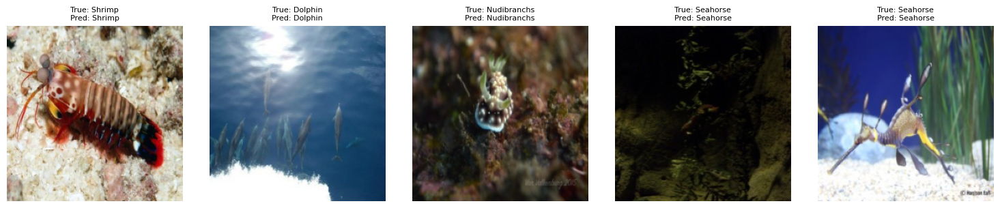


--- Training and Testing ResNet34 (Classical) ---

🚀 Training ClassicalCNN...
Using DataParallel for multi-GPU training.


/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/tmp/ipykernel_31/2903460415.py:31: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()
/tmp/ipykernel_31/2903460415.py:38: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Epoch 1/30, Train Loss: 3.1426, Train Acc: 9.05%, Val Loss: 2.7177, Val Acc: 36.39%
Epoch 2/30, Train Loss: 2.7894, Train Acc: 20.48%, Val Loss: 2.3969, Val Acc: 51.58%
Epoch 3/30, Train Loss: 2.5684, Train Acc: 28.87%, Val Loss: 2.1999, Val Acc: 61.58%
Epoch 4/30, Train Loss: 2.3883, Train Acc: 37.78%, Val Loss: 1.9925, Val Acc: 67.87%
Epoch 5/30, Train Loss: 2.2328, Train Acc: 44.19%, Val Loss: 1.8252, Val Acc: 70.15%
Epoch 6/30, Train Loss: 2.1017, Train Acc: 51.38%, Val Loss: 1.7215, Val Acc: 73.40%
Epoch 7/30, Train Loss: 1.9560, Train Acc: 57.81%, Val Loss: 1.5757, Val Acc: 75.10%
Epoch 8/30, Train Loss: 1.8247, Train Acc: 63.68%, Val Loss: 1.4698, Val Acc: 76.20%
Epoch 9/30, Train Loss: 1.7075, Train Acc: 67.54%, Val Loss: 1.4421, Val Acc: 76.89%
Epoch 10/30, Train Loss: 1.5831, Train Acc: 73.16%, Val Loss: 1.3511, Val Acc: 78.59%
Epoch 11/30, Train Loss: 1.4806, Train Acc: 76.31%, Val Loss: 1.2752, Val Acc: 79.04%
Epoch 12/30, Train Loss: 1.3690, Train Acc: 81.00%, Val Loss: 1.

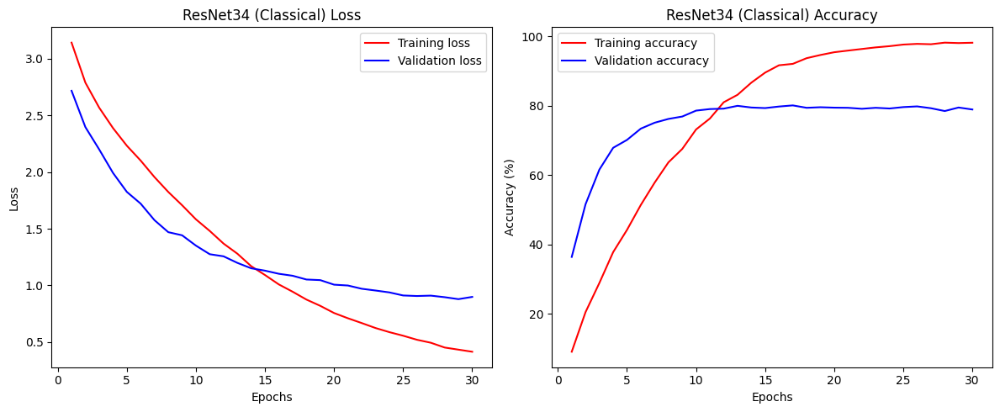

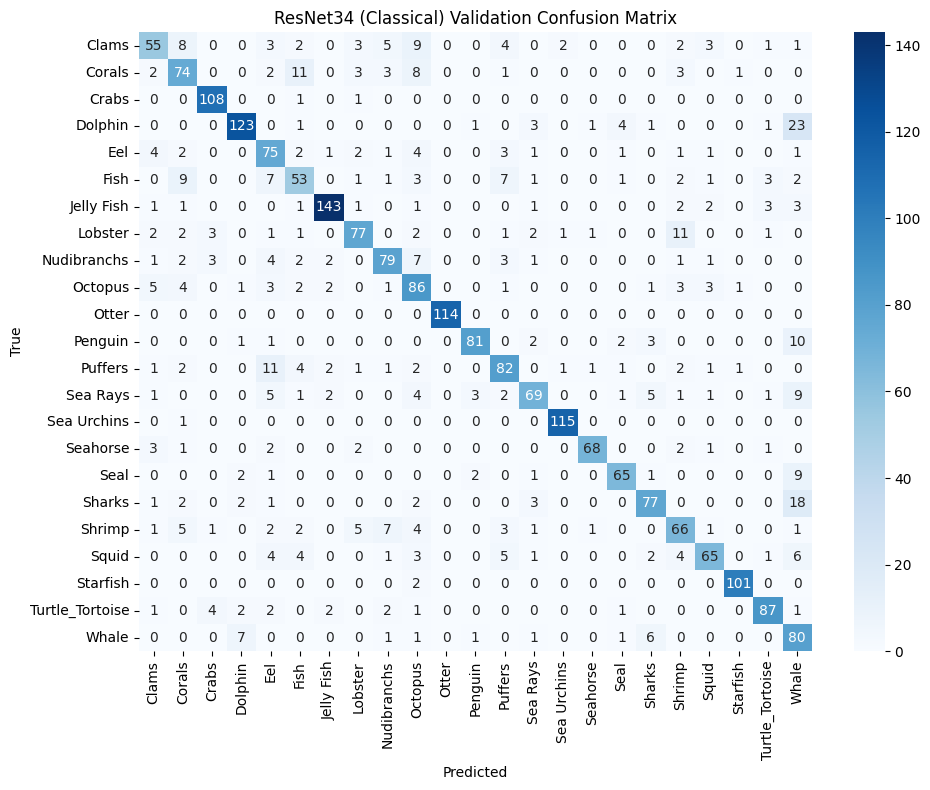


📊 Classification Report for ResNet34 (Classical) Validation:

                 precision    recall  f1-score   support

          Clams       0.71      0.56      0.62        98
         Corals       0.65      0.69      0.67       108
          Crabs       0.91      0.98      0.94       110
        Dolphin       0.89      0.78      0.83       158
            Eel       0.60      0.76      0.67        99
           Fish       0.61      0.58      0.60        91
     Jelly Fish       0.93      0.90      0.91       159
        Lobster       0.80      0.73      0.77       105
    Nudibranchs       0.77      0.75      0.76       106
        Octopus       0.62      0.76      0.68       113
          Otter       1.00      1.00      1.00       114
        Penguin       0.92      0.81      0.86       100
        Puffers       0.73      0.73      0.73       113
       Sea Rays       0.79      0.66      0.72       105
    Sea Urchins       0.97      0.99      0.98       116
       Seahorse       0.

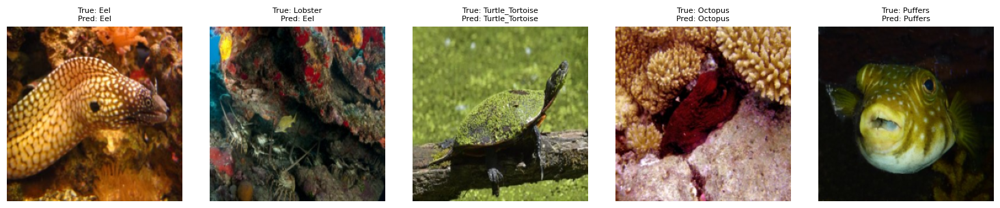


🔍 Testing started...
Using DataParallel for multi-GPU testing.

✅ Test Accuracy: 80.67%
📉 Test Loss: 0.8352

📊 Classification Report:

                 precision    recall  f1-score   support

          Clams       0.83      0.71      0.77       101
         Corals       0.59      0.82      0.68        92
          Crabs       0.89      0.96      0.92        90
        Dolphin       0.86      0.77      0.81       155
            Eel       0.59      0.75      0.66       100
           Fish       0.78      0.69      0.73       106
     Jelly Fish       0.93      0.92      0.93       179
        Lobster       0.82      0.68      0.75        95
    Nudibranchs       0.80      0.72      0.76        94
        Octopus       0.57      0.65      0.61       112
          Otter       0.99      1.00      0.99        86
        Penguin       0.93      0.84      0.88        93
        Puffers       0.84      0.72      0.77        99
       Sea Rays       0.76      0.68      0.72       102
    Sea 

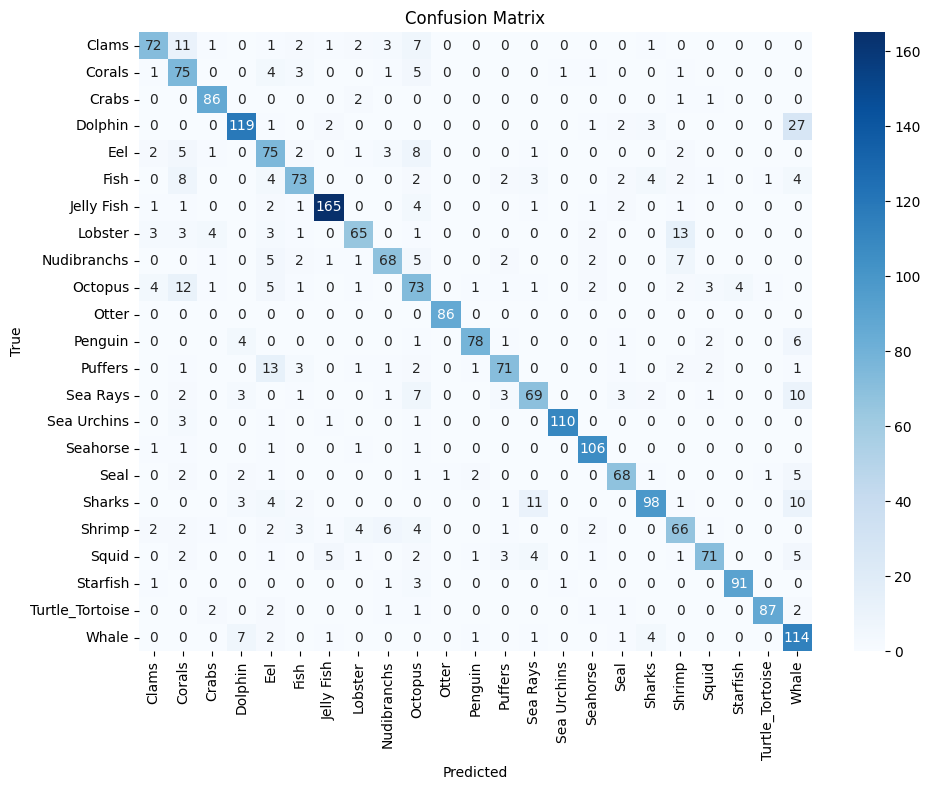

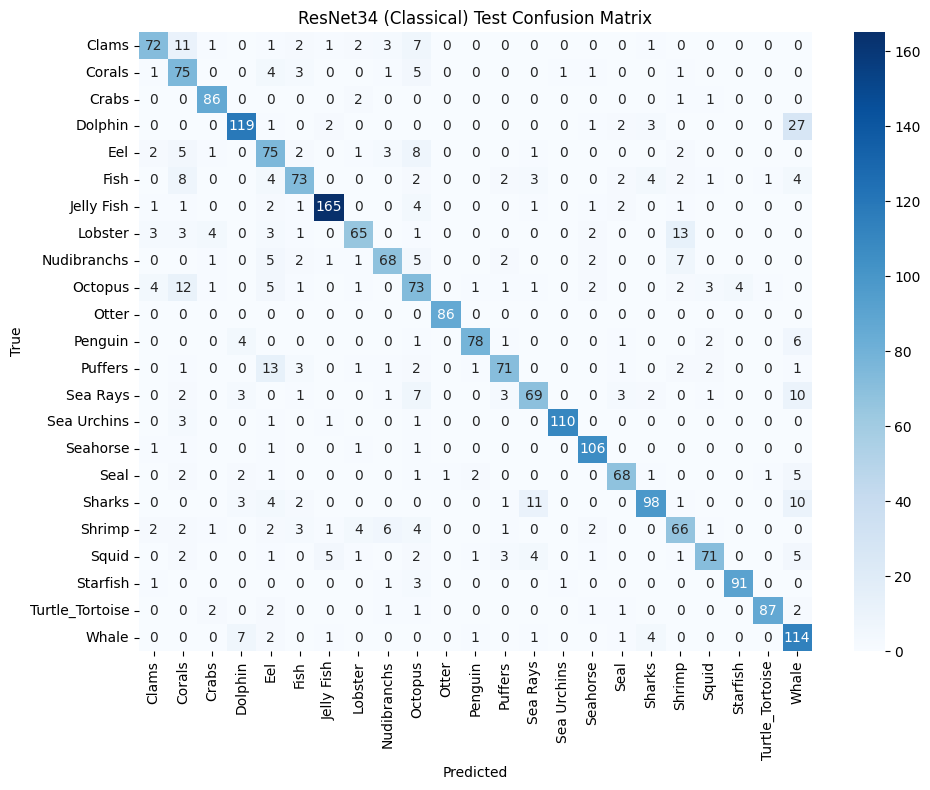


📊 Classification Report for ResNet34 (Classical) Test:

                 precision    recall  f1-score   support

          Clams       0.83      0.71      0.77       101
         Corals       0.59      0.82      0.68        92
          Crabs       0.89      0.96      0.92        90
        Dolphin       0.86      0.77      0.81       155
            Eel       0.59      0.75      0.66       100
           Fish       0.78      0.69      0.73       106
     Jelly Fish       0.93      0.92      0.93       179
        Lobster       0.82      0.68      0.75        95
    Nudibranchs       0.80      0.72      0.76        94
        Octopus       0.57      0.65      0.61       112
          Otter       0.99      1.00      0.99        86
        Penguin       0.93      0.84      0.88        93
        Puffers       0.84      0.72      0.77        99
       Sea Rays       0.76      0.68      0.72       102
    Sea Urchins       0.98      0.95      0.96       116
       Seahorse       0.89    

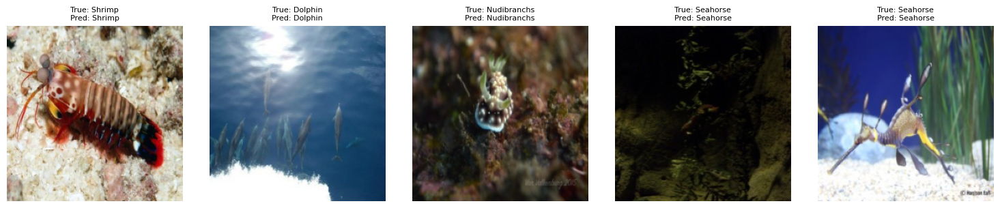


--- Training and Testing ResNet50 (Quantum) ---

🚀 Training HybridQCNN...
Using DataParallel for multi-GPU training.


/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/tmp/ipykernel_31/2903460415.py:31: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()
/tmp/ipykernel_31/2903460415.py:38: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Epoch 1/30, Train Loss: 3.2097, Train Acc: 6.66%, Val Loss: 2.9127, Val Acc: 28.07%
Epoch 2/30, Train Loss: 2.9378, Train Acc: 14.17%, Val Loss: 2.5810, Val Acc: 52.60%
Epoch 3/30, Train Loss: 2.6740, Train Acc: 25.08%, Val Loss: 2.2878, Val Acc: 61.41%
Epoch 4/30, Train Loss: 2.4527, Train Acc: 35.82%, Val Loss: 2.0595, Val Acc: 67.30%
Epoch 5/30, Train Loss: 2.2736, Train Acc: 43.74%, Val Loss: 1.9099, Val Acc: 72.54%
Epoch 6/30, Train Loss: 2.1176, Train Acc: 50.76%, Val Loss: 1.6891, Val Acc: 75.22%
Epoch 7/30, Train Loss: 1.9852, Train Acc: 56.54%, Val Loss: 1.6336, Val Acc: 78.64%
Epoch 8/30, Train Loss: 1.8658, Train Acc: 61.69%, Val Loss: 1.5151, Val Acc: 80.26%
Epoch 9/30, Train Loss: 1.7422, Train Acc: 67.28%, Val Loss: 1.4106, Val Acc: 80.95%
Epoch 10/30, Train Loss: 1.6323, Train Acc: 71.30%, Val Loss: 1.3064, Val Acc: 82.13%
Epoch 11/30, Train Loss: 1.5218, Train Acc: 75.70%, Val Loss: 1.2398, Val Acc: 82.58%
Epoch 12/30, Train Loss: 1.4160, Train Acc: 79.40%, Val Loss: 1.

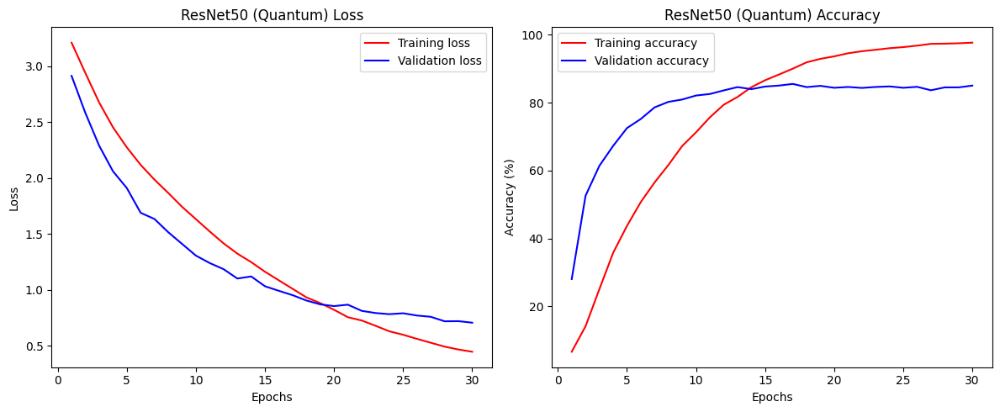

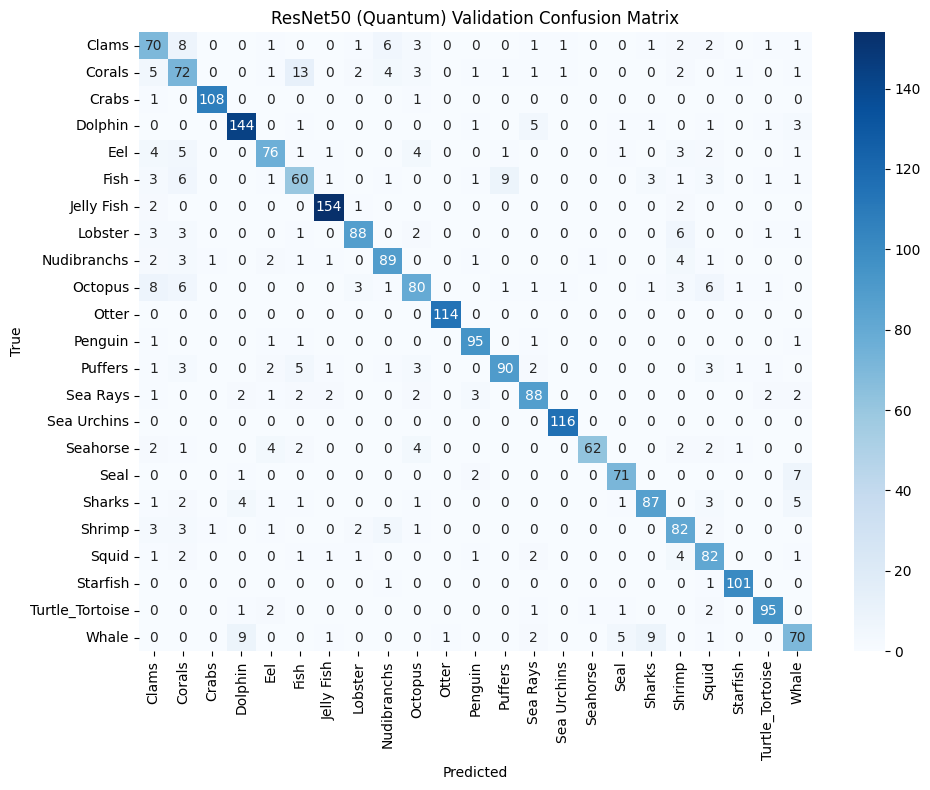


📊 Classification Report for ResNet50 (Quantum) Validation:

                 precision    recall  f1-score   support

          Clams       0.65      0.71      0.68        98
         Corals       0.63      0.67      0.65       108
          Crabs       0.98      0.98      0.98       110
        Dolphin       0.89      0.91      0.90       158
            Eel       0.82      0.77      0.79        99
           Fish       0.67      0.66      0.67        91
     Jelly Fish       0.95      0.97      0.96       159
        Lobster       0.90      0.84      0.87       105
    Nudibranchs       0.82      0.84      0.83       106
        Octopus       0.77      0.71      0.74       113
          Otter       0.99      1.00      1.00       114
        Penguin       0.90      0.95      0.93       100
        Puffers       0.88      0.80      0.84       113
       Sea Rays       0.85      0.84      0.84       105
    Sea Urchins       0.97      1.00      0.99       116
       Seahorse       0.97

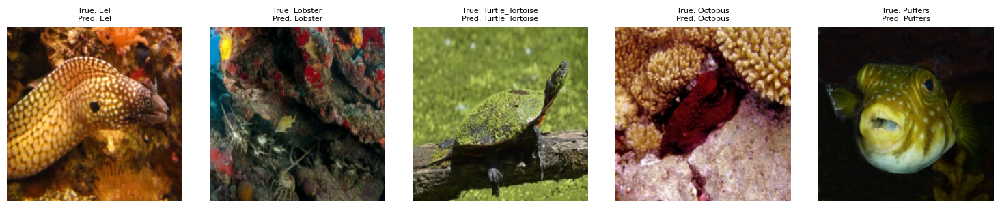


🔍 Testing started...
Using DataParallel for multi-GPU testing.

✅ Test Accuracy: 84.00%
📉 Test Loss: 0.7115

📊 Classification Report:

                 precision    recall  f1-score   support

          Clams       0.62      0.79      0.69       101
         Corals       0.60      0.83      0.69        92
          Crabs       0.93      0.96      0.95        90
        Dolphin       0.76      0.89      0.82       155
            Eel       0.91      0.73      0.81       100
           Fish       0.76      0.77      0.77       106
     Jelly Fish       0.96      0.96      0.96       179
        Lobster       0.82      0.84      0.83        95
    Nudibranchs       0.89      0.82      0.85        94
        Octopus       0.81      0.65      0.72       112
          Otter       0.99      1.00      0.99        86
        Penguin       0.93      0.90      0.92        93
        Puffers       0.89      0.78      0.83        99
       Sea Rays       0.83      0.82      0.83       102
    Sea 

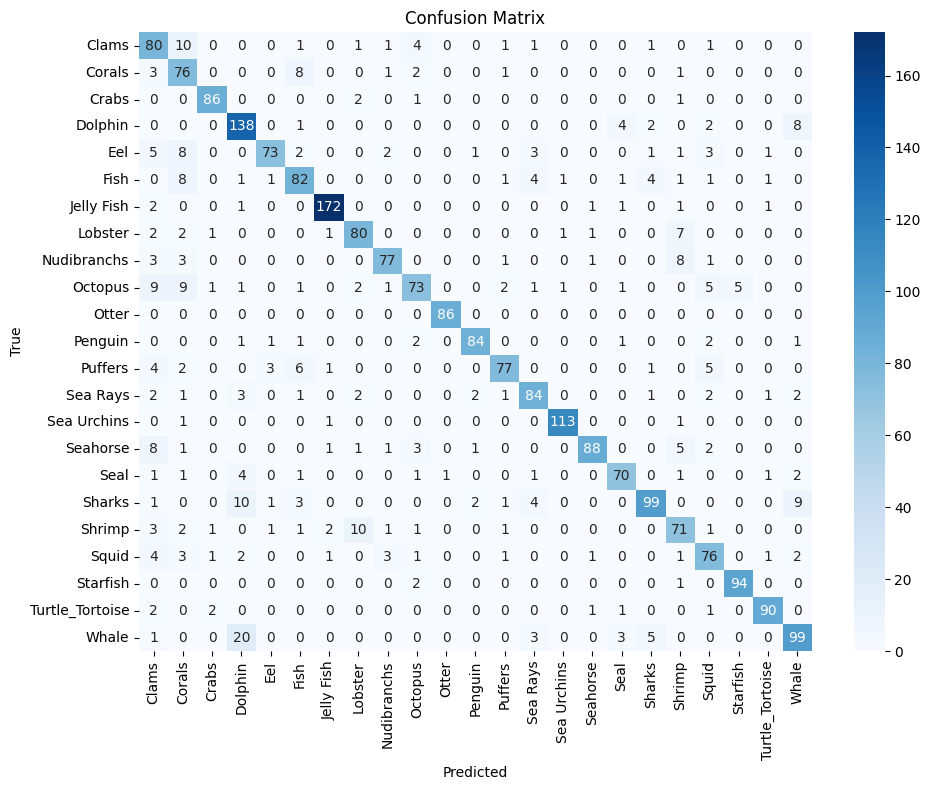

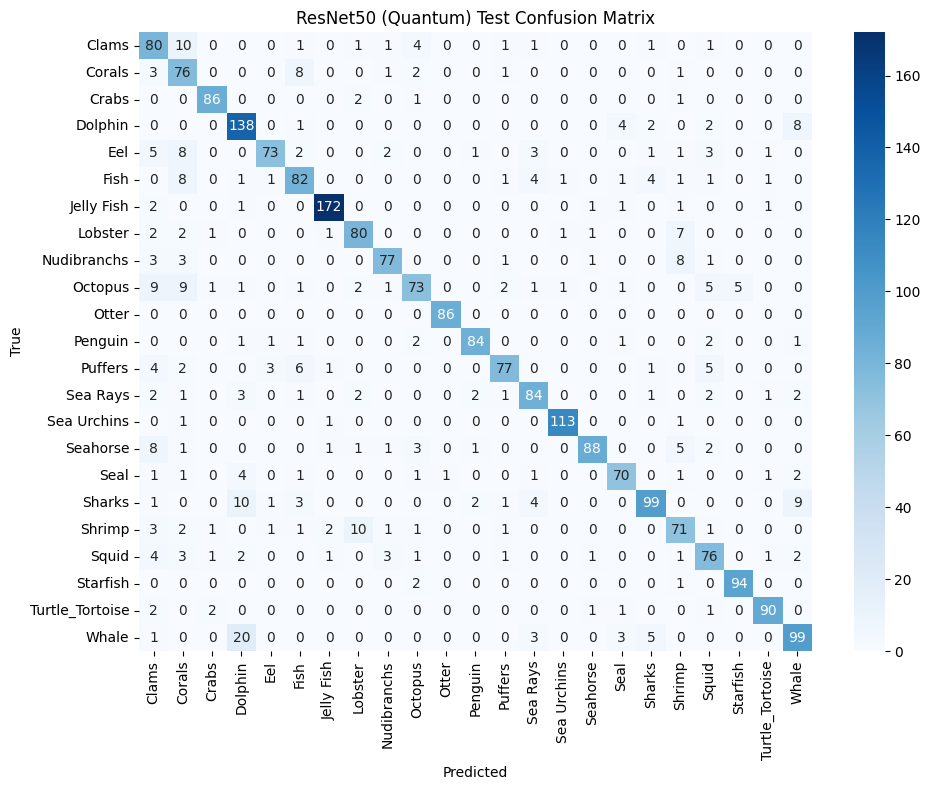


📊 Classification Report for ResNet50 (Quantum) Test:

                 precision    recall  f1-score   support

          Clams       0.62      0.79      0.69       101
         Corals       0.60      0.83      0.69        92
          Crabs       0.93      0.96      0.95        90
        Dolphin       0.76      0.89      0.82       155
            Eel       0.91      0.73      0.81       100
           Fish       0.76      0.77      0.77       106
     Jelly Fish       0.96      0.96      0.96       179
        Lobster       0.82      0.84      0.83        95
    Nudibranchs       0.89      0.82      0.85        94
        Octopus       0.81      0.65      0.72       112
          Otter       0.99      1.00      0.99        86
        Penguin       0.93      0.90      0.92        93
        Puffers       0.89      0.78      0.83        99
       Sea Rays       0.83      0.82      0.83       102
    Sea Urchins       0.97      0.97      0.97       116
       Seahorse       0.95      

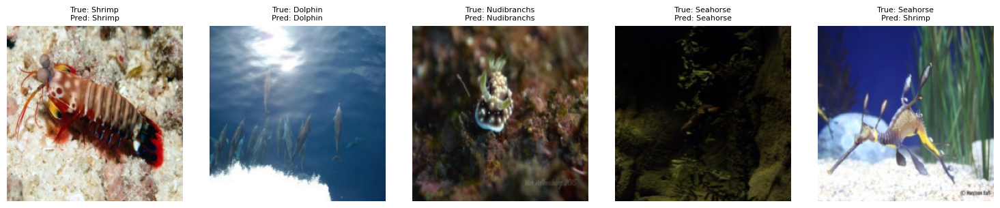


--- Training and Testing ResNet50 (Classical) ---

🚀 Training ClassicalCNN...
Using DataParallel for multi-GPU training.


/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/tmp/ipykernel_31/2903460415.py:31: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()
/tmp/ipykernel_31/2903460415.py:38: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Epoch 1/30, Train Loss: 3.2100, Train Acc: 6.49%, Val Loss: 2.9190, Val Acc: 29.81%
Epoch 2/30, Train Loss: 2.9567, Train Acc: 13.68%, Val Loss: 2.6072, Val Acc: 55.08%
Epoch 3/30, Train Loss: 2.6919, Train Acc: 24.39%, Val Loss: 2.3309, Val Acc: 66.61%
Epoch 4/30, Train Loss: 2.4540, Train Acc: 35.64%, Val Loss: 2.1358, Val Acc: 72.06%
Epoch 5/30, Train Loss: 2.2839, Train Acc: 44.56%, Val Loss: 1.8779, Val Acc: 75.63%
Epoch 6/30, Train Loss: 2.1042, Train Acc: 52.55%, Val Loss: 1.6868, Val Acc: 78.03%
Epoch 7/30, Train Loss: 1.9791, Train Acc: 58.04%, Val Loss: 1.5601, Val Acc: 80.50%
Epoch 8/30, Train Loss: 1.8432, Train Acc: 63.71%, Val Loss: 1.5104, Val Acc: 81.60%
Epoch 9/30, Train Loss: 1.7419, Train Acc: 67.93%, Val Loss: 1.4100, Val Acc: 82.66%
Epoch 10/30, Train Loss: 1.6127, Train Acc: 72.75%, Val Loss: 1.2928, Val Acc: 83.31%
Epoch 11/30, Train Loss: 1.5061, Train Acc: 76.30%, Val Loss: 1.2291, Val Acc: 83.47%
Epoch 12/30, Train Loss: 1.4181, Train Acc: 79.59%, Val Loss: 1.

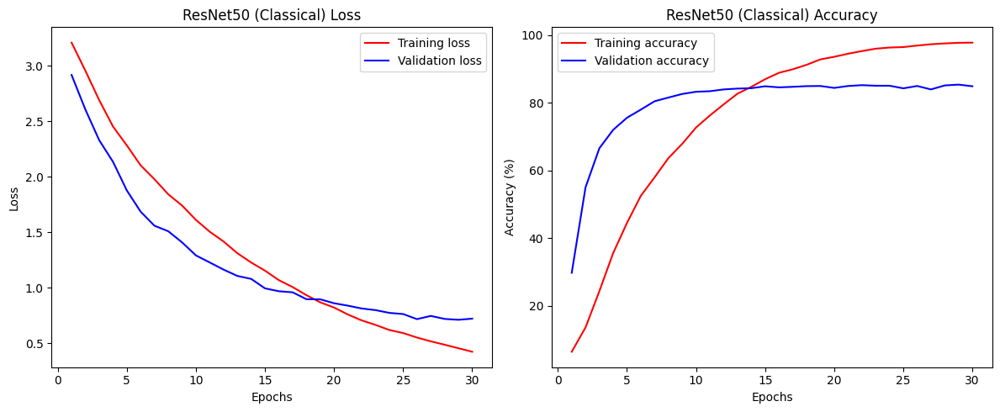

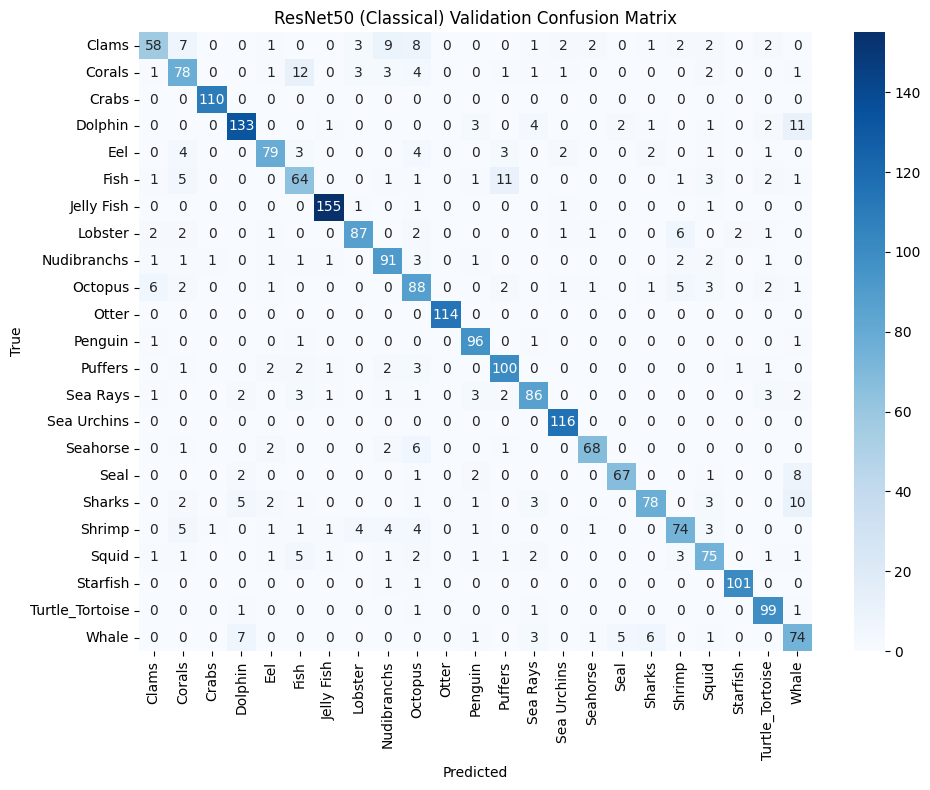


📊 Classification Report for ResNet50 (Classical) Validation:

                 precision    recall  f1-score   support

          Clams       0.81      0.59      0.68        98
         Corals       0.72      0.72      0.72       108
          Crabs       0.98      1.00      0.99       110
        Dolphin       0.89      0.84      0.86       158
            Eel       0.86      0.80      0.83        99
           Fish       0.69      0.70      0.70        91
     Jelly Fish       0.96      0.97      0.97       159
        Lobster       0.89      0.83      0.86       105
    Nudibranchs       0.79      0.86      0.82       106
        Octopus       0.67      0.78      0.72       113
          Otter       1.00      1.00      1.00       114
        Penguin       0.87      0.96      0.91       100
        Puffers       0.83      0.88      0.85       113
       Sea Rays       0.84      0.82      0.83       105
    Sea Urchins       0.94      1.00      0.97       116
       Seahorse       0.

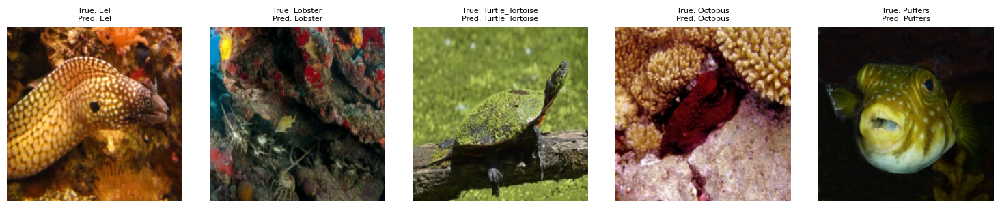


🔍 Testing started...
Using DataParallel for multi-GPU testing.

✅ Test Accuracy: 84.40%
📉 Test Loss: 0.7194

📊 Classification Report:

                 precision    recall  f1-score   support

          Clams       0.84      0.73      0.78       101
         Corals       0.63      0.83      0.72        92
          Crabs       0.91      0.96      0.93        90
        Dolphin       0.86      0.89      0.87       155
            Eel       0.86      0.73      0.79       100
           Fish       0.70      0.75      0.73       106
     Jelly Fish       0.97      0.97      0.97       179
        Lobster       0.87      0.81      0.84        95
    Nudibranchs       0.87      0.82      0.84        94
        Octopus       0.64      0.68      0.66       112
          Otter       0.99      1.00      0.99        86
        Penguin       0.88      0.94      0.91        93
        Puffers       0.80      0.87      0.83        99
       Sea Rays       0.77      0.76      0.77       102
    Sea 

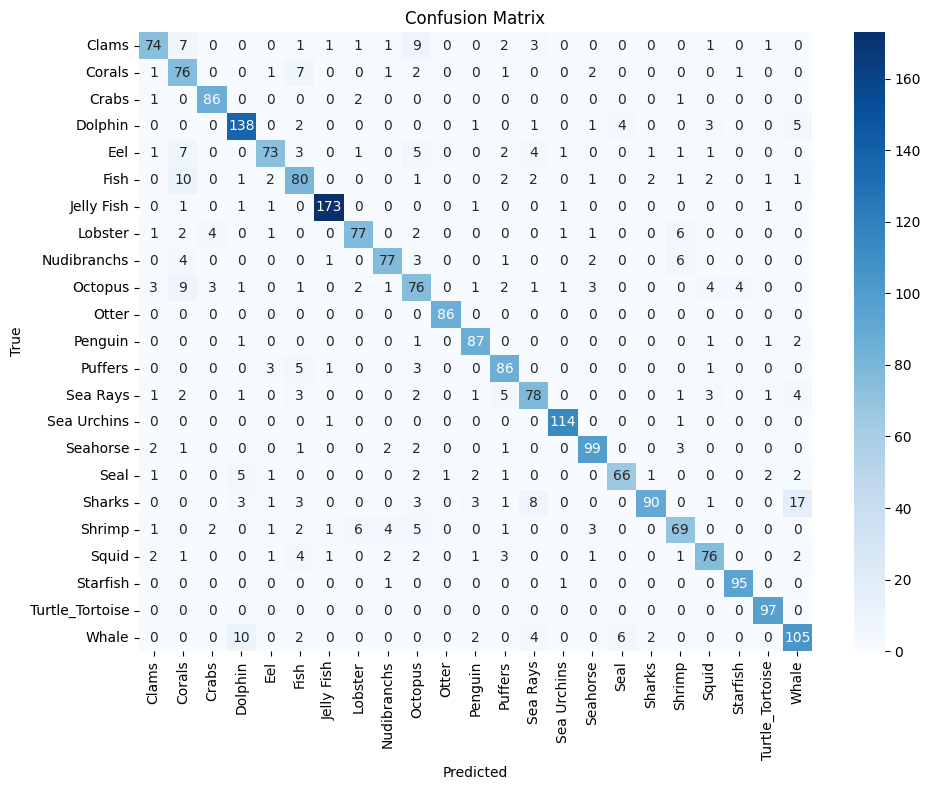

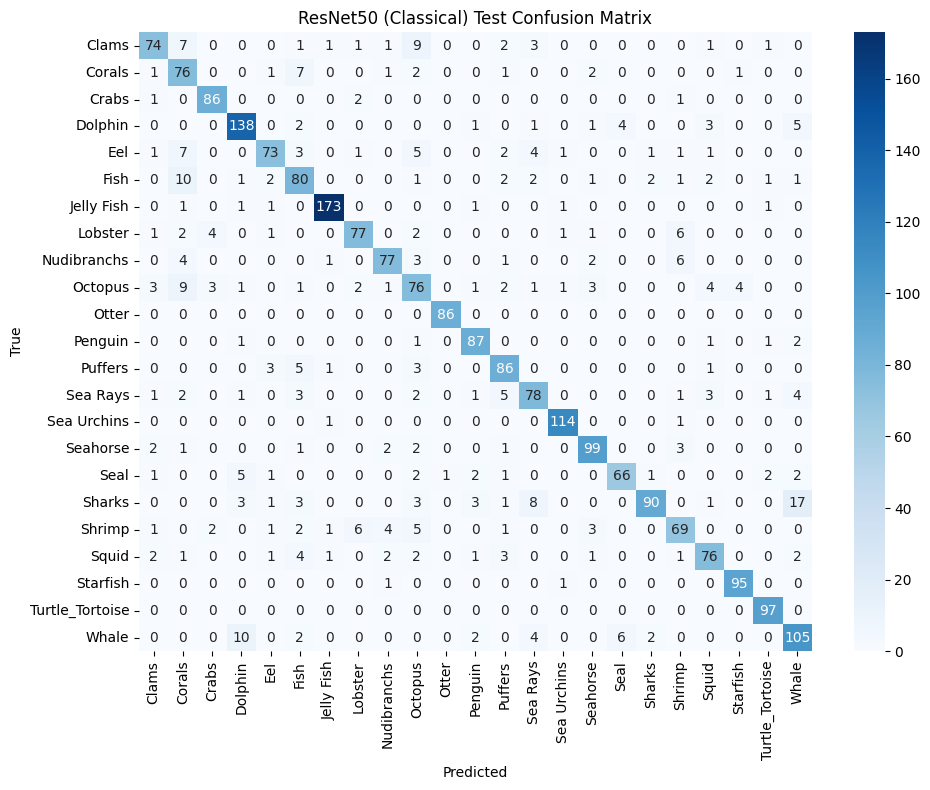


📊 Classification Report for ResNet50 (Classical) Test:

                 precision    recall  f1-score   support

          Clams       0.84      0.73      0.78       101
         Corals       0.63      0.83      0.72        92
          Crabs       0.91      0.96      0.93        90
        Dolphin       0.86      0.89      0.87       155
            Eel       0.86      0.73      0.79       100
           Fish       0.70      0.75      0.73       106
     Jelly Fish       0.97      0.97      0.97       179
        Lobster       0.87      0.81      0.84        95
    Nudibranchs       0.87      0.82      0.84        94
        Octopus       0.64      0.68      0.66       112
          Otter       0.99      1.00      0.99        86
        Penguin       0.88      0.94      0.91        93
        Puffers       0.80      0.87      0.83        99
       Sea Rays       0.77      0.76      0.77       102
    Sea Urchins       0.96      0.98      0.97       116
       Seahorse       0.88    

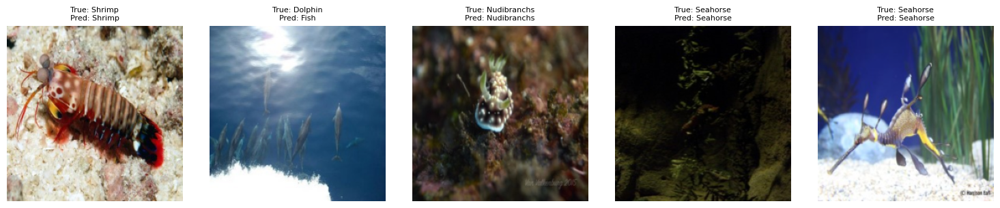


--- Training and Testing ResNet101 (Quantum) ---

🚀 Training HybridQCNN...
Using DataParallel for multi-GPU training.


/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/tmp/ipykernel_31/2903460415.py:31: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()
/tmp/ipykernel_31/2903460415.py:38: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Epoch 1/30, Train Loss: 3.1980, Train Acc: 6.47%, Val Loss: 2.8834, Val Acc: 28.27%
Epoch 2/30, Train Loss: 2.9052, Train Acc: 15.36%, Val Loss: 2.5319, Val Acc: 55.40%
Epoch 3/30, Train Loss: 2.6149, Train Acc: 28.01%, Val Loss: 2.2064, Val Acc: 69.13%
Epoch 4/30, Train Loss: 2.3722, Train Acc: 39.91%, Val Loss: 1.9581, Val Acc: 74.00%
Epoch 5/30, Train Loss: 2.1769, Train Acc: 49.78%, Val Loss: 1.7552, Val Acc: 77.34%
Epoch 6/30, Train Loss: 2.0204, Train Acc: 56.70%, Val Loss: 1.5843, Val Acc: 80.02%
Epoch 7/30, Train Loss: 1.8771, Train Acc: 63.72%, Val Loss: 1.4550, Val Acc: 82.01%
Epoch 8/30, Train Loss: 1.7326, Train Acc: 69.61%, Val Loss: 1.3398, Val Acc: 82.45%
Epoch 9/30, Train Loss: 1.6205, Train Acc: 74.28%, Val Loss: 1.2986, Val Acc: 83.31%
Epoch 10/30, Train Loss: 1.5004, Train Acc: 77.98%, Val Loss: 1.2443, Val Acc: 84.08%
Epoch 11/30, Train Loss: 1.3885, Train Acc: 81.72%, Val Loss: 1.1493, Val Acc: 84.73%
Epoch 12/30, Train Loss: 1.2905, Train Acc: 85.33%, Val Loss: 1.

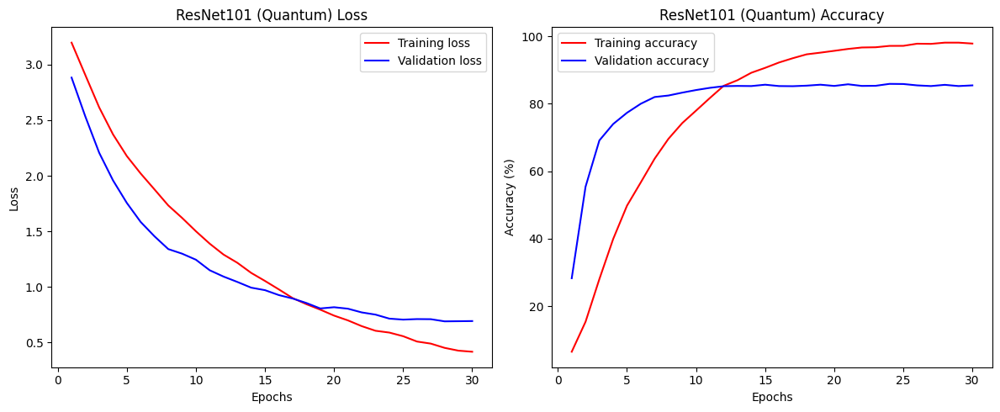

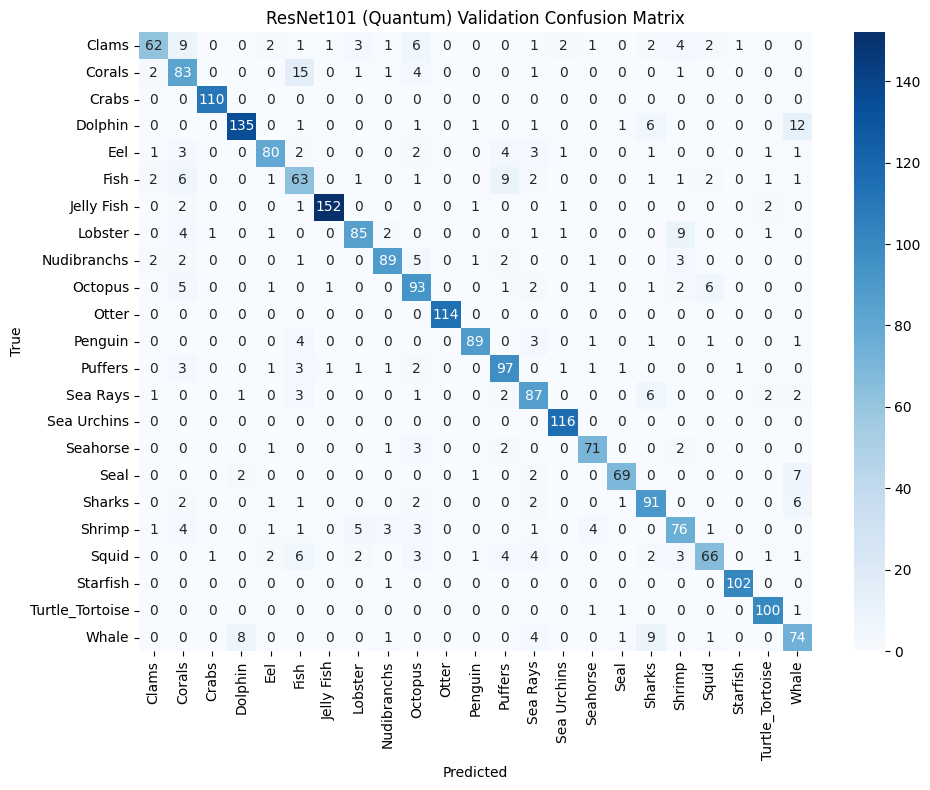


📊 Classification Report for ResNet101 (Quantum) Validation:

                 precision    recall  f1-score   support

          Clams       0.87      0.63      0.73        98
         Corals       0.67      0.77      0.72       108
          Crabs       0.98      1.00      0.99       110
        Dolphin       0.92      0.85      0.89       158
            Eel       0.88      0.81      0.84        99
           Fish       0.62      0.69      0.65        91
     Jelly Fish       0.98      0.96      0.97       159
        Lobster       0.87      0.81      0.84       105
    Nudibranchs       0.89      0.84      0.86       106
        Octopus       0.74      0.82      0.78       113
          Otter       1.00      1.00      1.00       114
        Penguin       0.95      0.89      0.92       100
        Puffers       0.80      0.86      0.83       113
       Sea Rays       0.76      0.83      0.79       105
    Sea Urchins       0.95      1.00      0.97       116
       Seahorse       0.8

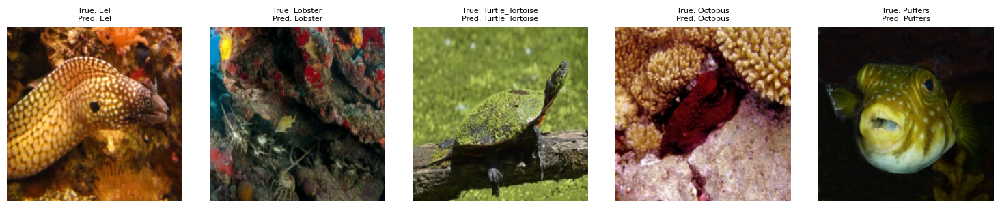


🔍 Testing started...
Using DataParallel for multi-GPU testing.

✅ Test Accuracy: 86.39%
📉 Test Loss: 0.6488

📊 Classification Report:

                 precision    recall  f1-score   support

          Clams       0.90      0.76      0.82       101
         Corals       0.61      0.86      0.71        92
          Crabs       0.95      0.98      0.96        90
        Dolphin       0.89      0.84      0.86       155
            Eel       0.89      0.83      0.86       100
           Fish       0.77      0.77      0.77       106
     Jelly Fish       0.97      0.94      0.96       179
        Lobster       0.86      0.82      0.84        95
    Nudibranchs       0.94      0.79      0.86        94
        Octopus       0.69      0.77      0.73       112
          Otter       0.98      1.00      0.99        86
        Penguin       0.98      0.89      0.93        93
        Puffers       0.85      0.89      0.87        99
       Sea Rays       0.76      0.83      0.79       102
    Sea 

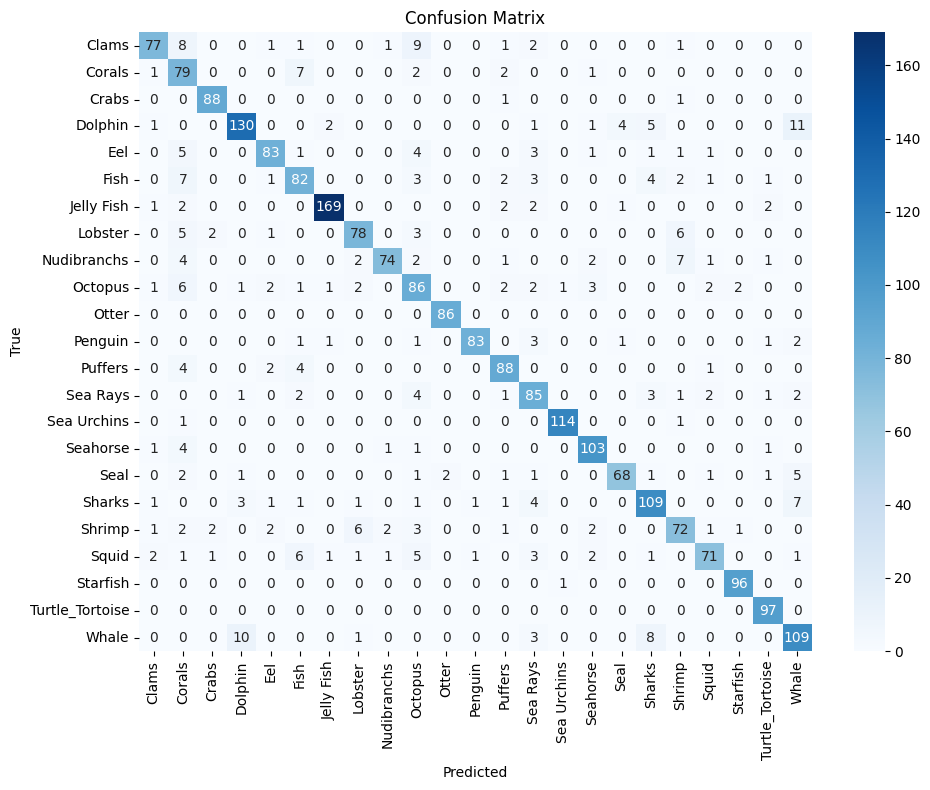

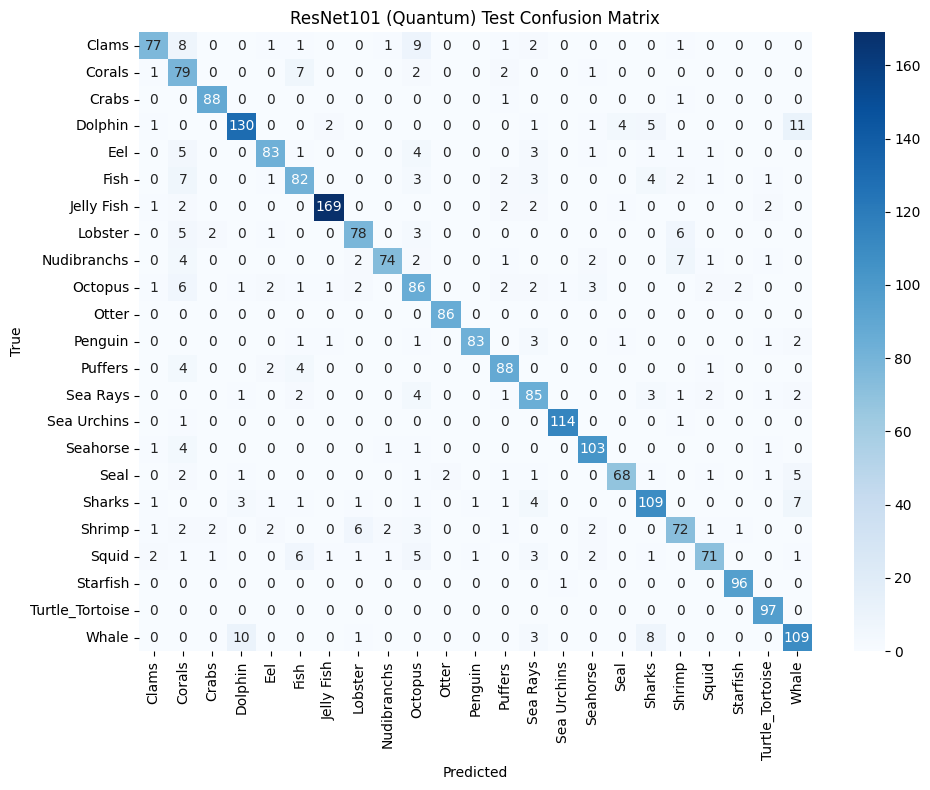


📊 Classification Report for ResNet101 (Quantum) Test:

                 precision    recall  f1-score   support

          Clams       0.90      0.76      0.82       101
         Corals       0.61      0.86      0.71        92
          Crabs       0.95      0.98      0.96        90
        Dolphin       0.89      0.84      0.86       155
            Eel       0.89      0.83      0.86       100
           Fish       0.77      0.77      0.77       106
     Jelly Fish       0.97      0.94      0.96       179
        Lobster       0.86      0.82      0.84        95
    Nudibranchs       0.94      0.79      0.86        94
        Octopus       0.69      0.77      0.73       112
          Otter       0.98      1.00      0.99        86
        Penguin       0.98      0.89      0.93        93
        Puffers       0.85      0.89      0.87        99
       Sea Rays       0.76      0.83      0.79       102
    Sea Urchins       0.98      0.98      0.98       116
       Seahorse       0.90     

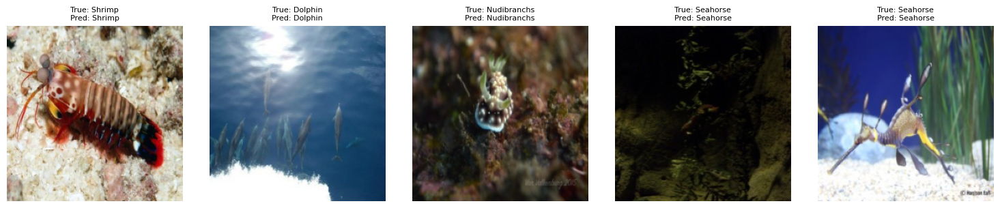


--- Training and Testing ResNet101 (Classical) ---

🚀 Training ClassicalCNN...
Using DataParallel for multi-GPU training.


/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/tmp/ipykernel_31/2903460415.py:31: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()
/tmp/ipykernel_31/2903460415.py:38: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Epoch 1/30, Train Loss: 3.1888, Train Acc: 6.89%, Val Loss: 2.8823, Val Acc: 30.14%
Epoch 2/30, Train Loss: 2.9068, Train Acc: 16.64%, Val Loss: 2.5237, Val Acc: 56.86%
Epoch 3/30, Train Loss: 2.6018, Train Acc: 28.89%, Val Loss: 2.2213, Val Acc: 67.71%
Epoch 4/30, Train Loss: 2.3640, Train Acc: 40.06%, Val Loss: 1.9521, Val Acc: 72.62%
Epoch 5/30, Train Loss: 2.1940, Train Acc: 47.48%, Val Loss: 1.7759, Val Acc: 76.69%
Epoch 6/30, Train Loss: 2.0125, Train Acc: 55.86%, Val Loss: 1.6084, Val Acc: 79.65%
Epoch 7/30, Train Loss: 1.8846, Train Acc: 62.12%, Val Loss: 1.4661, Val Acc: 81.15%
Epoch 8/30, Train Loss: 1.7513, Train Acc: 67.98%, Val Loss: 1.3636, Val Acc: 82.09%
Epoch 9/30, Train Loss: 1.6296, Train Acc: 73.48%, Val Loss: 1.2530, Val Acc: 83.14%
Epoch 10/30, Train Loss: 1.5159, Train Acc: 77.40%, Val Loss: 1.2808, Val Acc: 83.75%
Epoch 11/30, Train Loss: 1.3986, Train Acc: 81.43%, Val Loss: 1.1375, Val Acc: 84.85%
Epoch 12/30, Train Loss: 1.3101, Train Acc: 84.74%, Val Loss: 1.

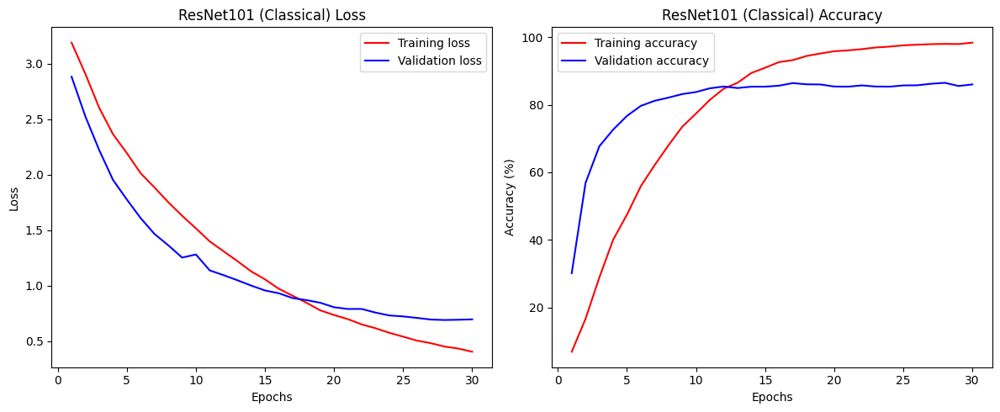

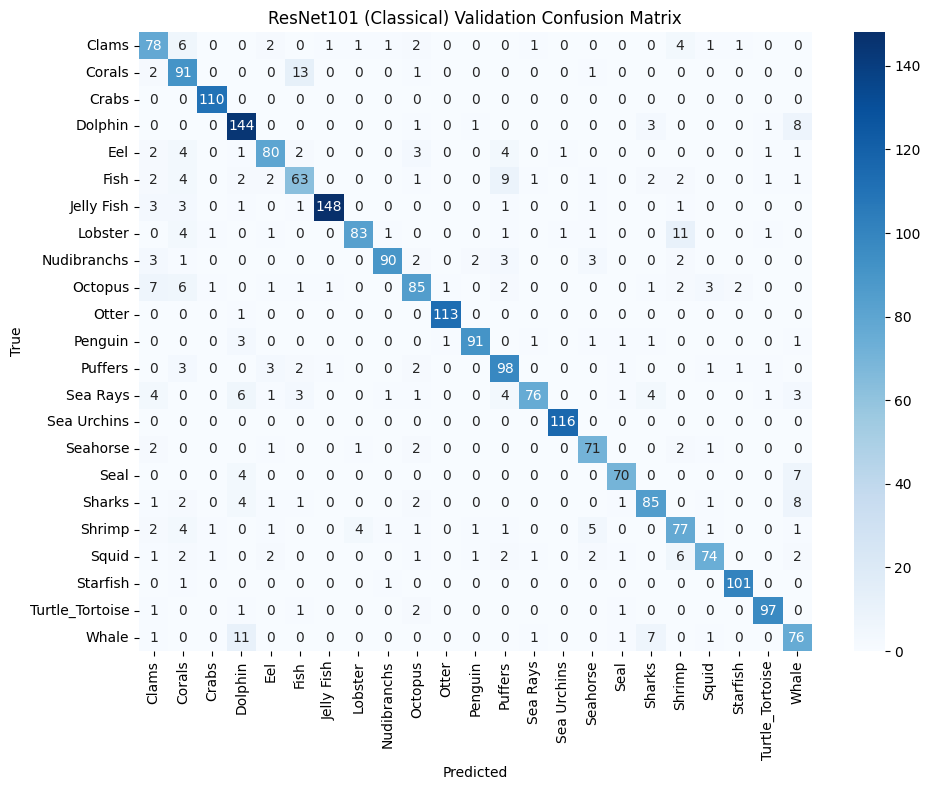


📊 Classification Report for ResNet101 (Classical) Validation:

                 precision    recall  f1-score   support

          Clams       0.72      0.80      0.75        98
         Corals       0.69      0.84      0.76       108
          Crabs       0.96      1.00      0.98       110
        Dolphin       0.81      0.91      0.86       158
            Eel       0.84      0.81      0.82        99
           Fish       0.72      0.69      0.71        91
     Jelly Fish       0.98      0.93      0.95       159
        Lobster       0.93      0.79      0.86       105
    Nudibranchs       0.95      0.85      0.90       106
        Octopus       0.80      0.75      0.78       113
          Otter       0.98      0.99      0.99       114
        Penguin       0.95      0.91      0.93       100
        Puffers       0.78      0.87      0.82       113
       Sea Rays       0.94      0.72      0.82       105
    Sea Urchins       0.98      1.00      0.99       116
       Seahorse       0

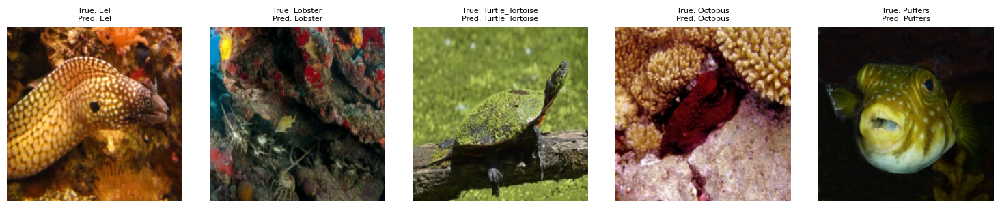


🔍 Testing started...
Using DataParallel for multi-GPU testing.

✅ Test Accuracy: 85.42%
📉 Test Loss: 0.7032

📊 Classification Report:

                 precision    recall  f1-score   support

          Clams       0.72      0.82      0.77       101
         Corals       0.58      0.86      0.69        92
          Crabs       0.92      0.99      0.95        90
        Dolphin       0.80      0.92      0.86       155
            Eel       0.90      0.81      0.85       100
           Fish       0.77      0.73      0.75       106
     Jelly Fish       0.99      0.93      0.96       179
        Lobster       0.96      0.78      0.86        95
    Nudibranchs       0.95      0.78      0.85        94
        Octopus       0.75      0.69      0.72       112
          Otter       0.99      1.00      0.99        86
        Penguin       0.94      0.87      0.91        93
        Puffers       0.89      0.89      0.89        99
       Sea Rays       0.85      0.71      0.77       102
    Sea 

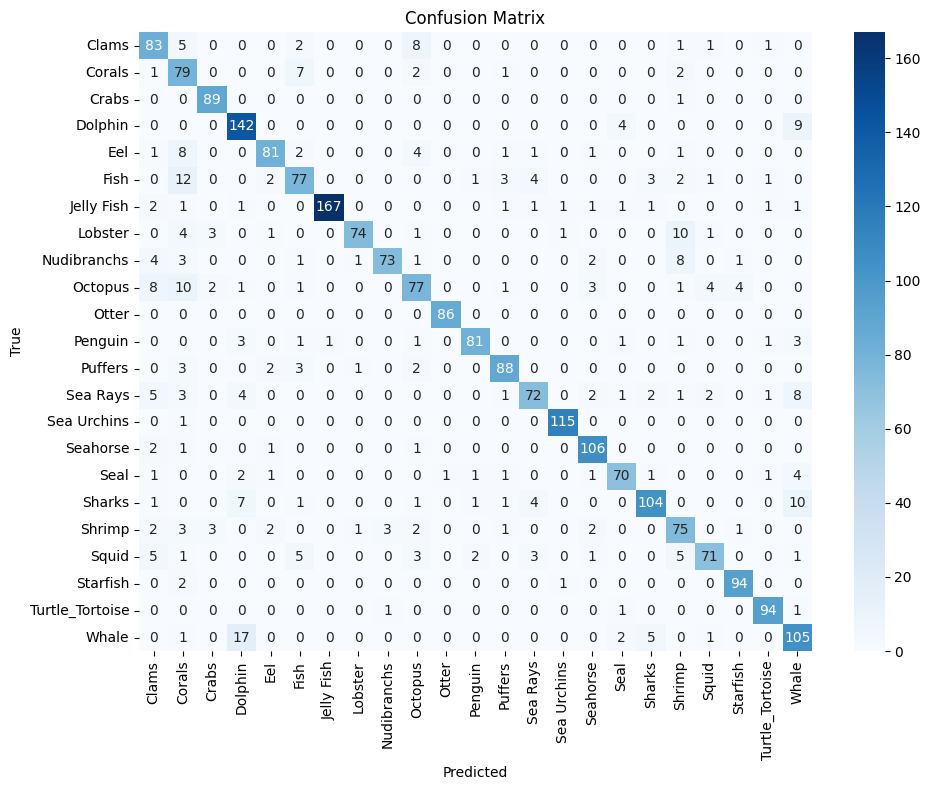

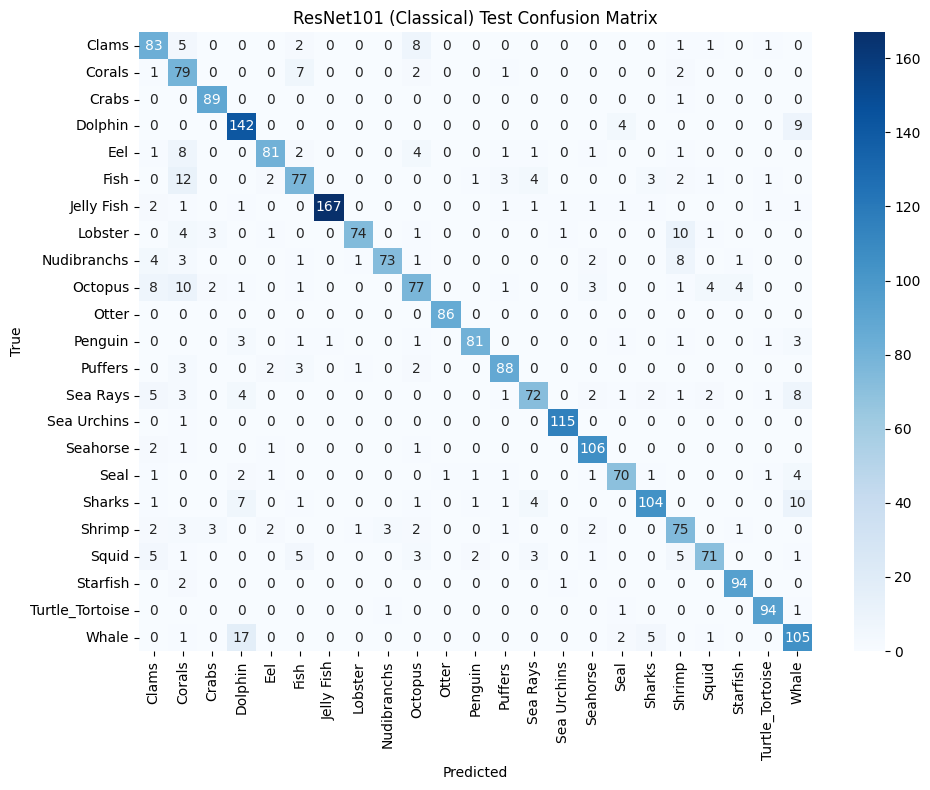


📊 Classification Report for ResNet101 (Classical) Test:

                 precision    recall  f1-score   support

          Clams       0.72      0.82      0.77       101
         Corals       0.58      0.86      0.69        92
          Crabs       0.92      0.99      0.95        90
        Dolphin       0.80      0.92      0.86       155
            Eel       0.90      0.81      0.85       100
           Fish       0.77      0.73      0.75       106
     Jelly Fish       0.99      0.93      0.96       179
        Lobster       0.96      0.78      0.86        95
    Nudibranchs       0.95      0.78      0.85        94
        Octopus       0.75      0.69      0.72       112
          Otter       0.99      1.00      0.99        86
        Penguin       0.94      0.87      0.91        93
        Puffers       0.89      0.89      0.89        99
       Sea Rays       0.85      0.71      0.77       102
    Sea Urchins       0.97      0.99      0.98       116
       Seahorse       0.89   

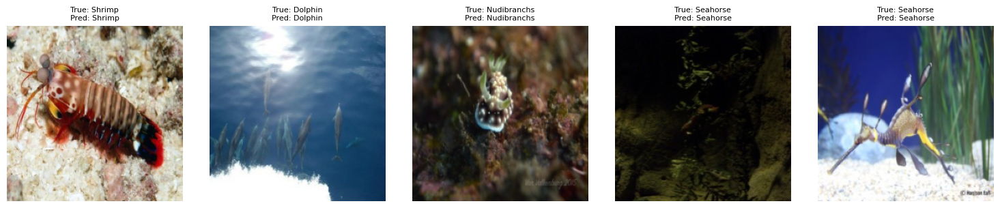


--- Training and Testing DenseNet121 (Quantum) ---

🚀 Training HybridQCNN...
Using DataParallel for multi-GPU training.


/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/tmp/ipykernel_31/2903460415.py:31: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()
/tmp/ipykernel_31/2903460415.py:38: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Epoch 1/30, Train Loss: 3.2014, Train Acc: 6.74%, Val Loss: 2.8802, Val Acc: 28.15%
Epoch 2/30, Train Loss: 2.9562, Train Acc: 12.81%, Val Loss: 2.6278, Val Acc: 49.43%
Epoch 3/30, Train Loss: 2.7452, Train Acc: 21.71%, Val Loss: 2.3923, Val Acc: 59.75%
Epoch 4/30, Train Loss: 2.5768, Train Acc: 29.63%, Val Loss: 2.2361, Val Acc: 66.25%
Epoch 5/30, Train Loss: 2.4433, Train Acc: 35.66%, Val Loss: 2.0709, Val Acc: 69.50%
Epoch 6/30, Train Loss: 2.3045, Train Acc: 41.87%, Val Loss: 1.9304, Val Acc: 72.18%
Epoch 7/30, Train Loss: 2.1762, Train Acc: 47.22%, Val Loss: 1.8134, Val Acc: 72.87%
Epoch 8/30, Train Loss: 2.0829, Train Acc: 51.15%, Val Loss: 1.7012, Val Acc: 75.43%
Epoch 9/30, Train Loss: 1.9754, Train Acc: 55.24%, Val Loss: 1.6199, Val Acc: 76.32%
Epoch 10/30, Train Loss: 1.8930, Train Acc: 58.61%, Val Loss: 1.5016, Val Acc: 77.21%
Epoch 11/30, Train Loss: 1.8073, Train Acc: 62.24%, Val Loss: 1.4667, Val Acc: 77.82%
Epoch 12/30, Train Loss: 1.7225, Train Acc: 65.56%, Val Loss: 1.

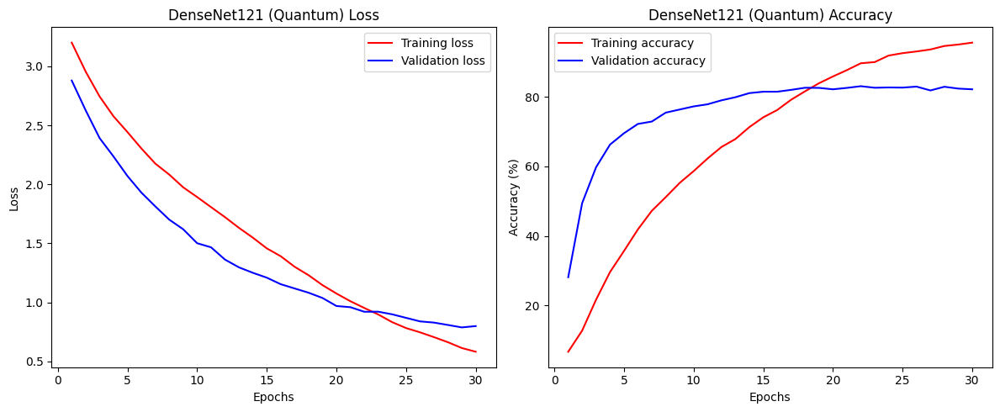

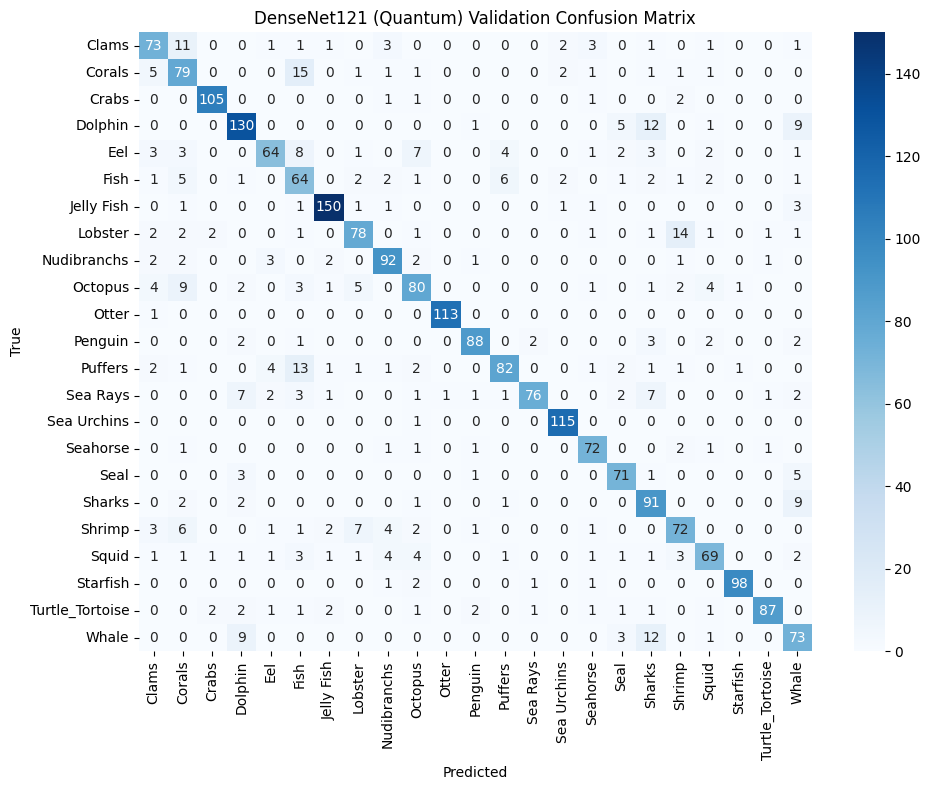


📊 Classification Report for DenseNet121 (Quantum) Validation:

                 precision    recall  f1-score   support

          Clams       0.75      0.74      0.75        98
         Corals       0.64      0.73      0.68       108
          Crabs       0.95      0.95      0.95       110
        Dolphin       0.82      0.82      0.82       158
            Eel       0.83      0.65      0.73        99
           Fish       0.56      0.70      0.62        91
     Jelly Fish       0.93      0.94      0.94       159
        Lobster       0.80      0.74      0.77       105
    Nudibranchs       0.83      0.87      0.85       106
        Octopus       0.74      0.71      0.72       113
          Otter       0.99      0.99      0.99       114
        Penguin       0.92      0.88      0.90       100
        Puffers       0.86      0.73      0.79       113
       Sea Rays       0.95      0.72      0.82       105
    Sea Urchins       0.94      0.99      0.97       116
       Seahorse       0

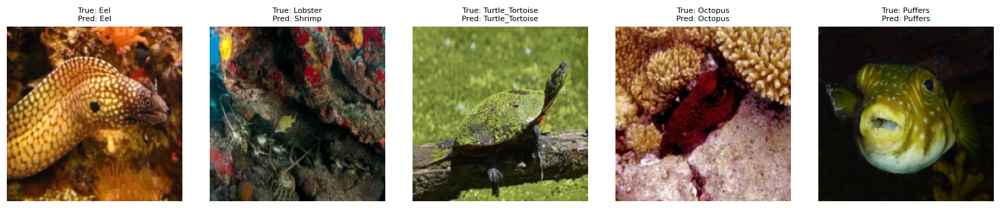


🔍 Testing started...
Using DataParallel for multi-GPU testing.

✅ Test Accuracy: 82.17%
📉 Test Loss: 0.7844

📊 Classification Report:

                 precision    recall  f1-score   support

          Clams       0.75      0.80      0.78       101
         Corals       0.59      0.78      0.67        92
          Crabs       0.95      0.97      0.96        90
        Dolphin       0.81      0.89      0.85       155
            Eel       0.82      0.61      0.70       100
           Fish       0.64      0.75      0.69       106
     Jelly Fish       0.95      0.92      0.93       179
        Lobster       0.88      0.80      0.84        95
    Nudibranchs       0.78      0.84      0.81        94
        Octopus       0.69      0.67      0.68       112
          Otter       0.97      1.00      0.98        86
        Penguin       0.91      0.87      0.89        93
        Puffers       0.84      0.69      0.76        99
       Sea Rays       0.82      0.68      0.74       102
    Sea 

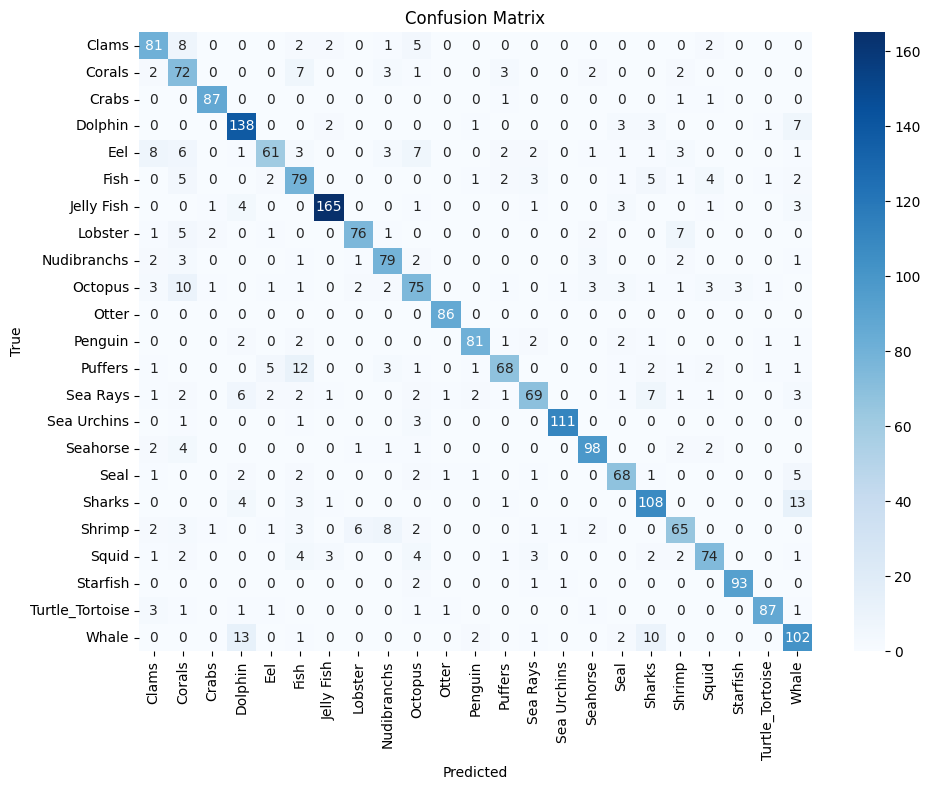

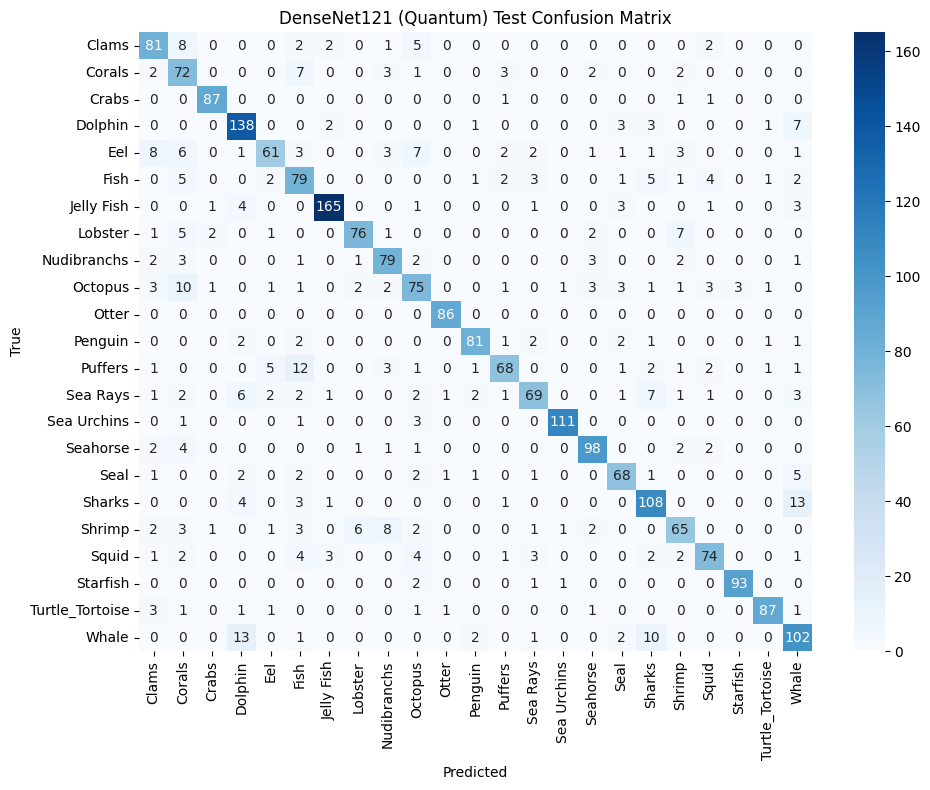


📊 Classification Report for DenseNet121 (Quantum) Test:

                 precision    recall  f1-score   support

          Clams       0.75      0.80      0.78       101
         Corals       0.59      0.78      0.67        92
          Crabs       0.95      0.97      0.96        90
        Dolphin       0.81      0.89      0.85       155
            Eel       0.82      0.61      0.70       100
           Fish       0.64      0.75      0.69       106
     Jelly Fish       0.95      0.92      0.93       179
        Lobster       0.88      0.80      0.84        95
    Nudibranchs       0.78      0.84      0.81        94
        Octopus       0.69      0.67      0.68       112
          Otter       0.97      1.00      0.98        86
        Penguin       0.91      0.87      0.89        93
        Puffers       0.84      0.69      0.76        99
       Sea Rays       0.82      0.68      0.74       102
    Sea Urchins       0.97      0.96      0.97       116
       Seahorse       0.88   

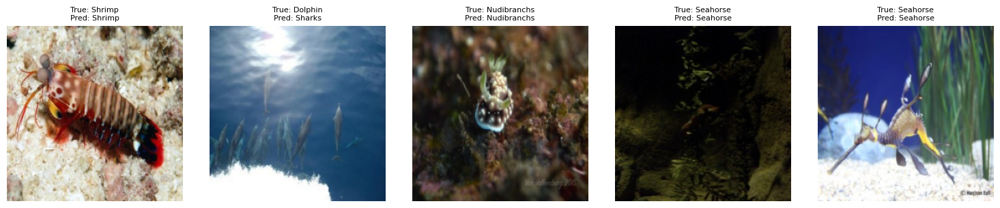


--- Training and Testing DenseNet121 (Classical) ---

🚀 Training ClassicalCNN...
Using DataParallel for multi-GPU training.


/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/tmp/ipykernel_31/2903460415.py:31: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()
/tmp/ipykernel_31/2903460415.py:38: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Epoch 1/30, Train Loss: 3.2132, Train Acc: 6.45%, Val Loss: 2.8869, Val Acc: 25.91%
Epoch 2/30, Train Loss: 2.9660, Train Acc: 13.42%, Val Loss: 2.6460, Val Acc: 43.91%
Epoch 3/30, Train Loss: 2.7711, Train Acc: 20.87%, Val Loss: 2.4268, Val Acc: 53.21%
Epoch 4/30, Train Loss: 2.6047, Train Acc: 27.48%, Val Loss: 2.2409, Val Acc: 59.75%
Epoch 5/30, Train Loss: 2.4632, Train Acc: 33.91%, Val Loss: 2.0854, Val Acc: 64.99%
Epoch 6/30, Train Loss: 2.3426, Train Acc: 39.29%, Val Loss: 1.9790, Val Acc: 69.42%
Epoch 7/30, Train Loss: 2.2238, Train Acc: 44.46%, Val Loss: 1.8310, Val Acc: 71.89%
Epoch 8/30, Train Loss: 2.1105, Train Acc: 49.30%, Val Loss: 1.7586, Val Acc: 74.65%
Epoch 9/30, Train Loss: 2.0152, Train Acc: 53.78%, Val Loss: 1.6450, Val Acc: 76.40%
Epoch 10/30, Train Loss: 1.9240, Train Acc: 57.27%, Val Loss: 1.5816, Val Acc: 77.58%
Epoch 11/30, Train Loss: 1.8337, Train Acc: 60.67%, Val Loss: 1.5081, Val Acc: 78.07%
Epoch 12/30, Train Loss: 1.7500, Train Acc: 63.68%, Val Loss: 1.

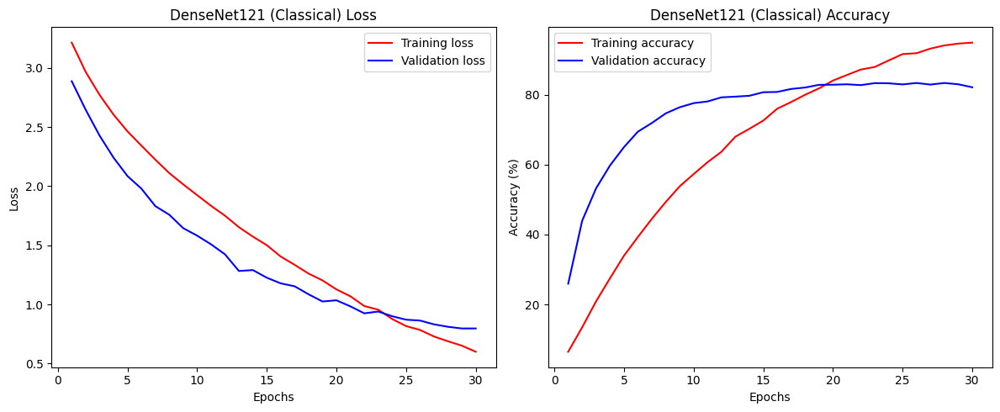

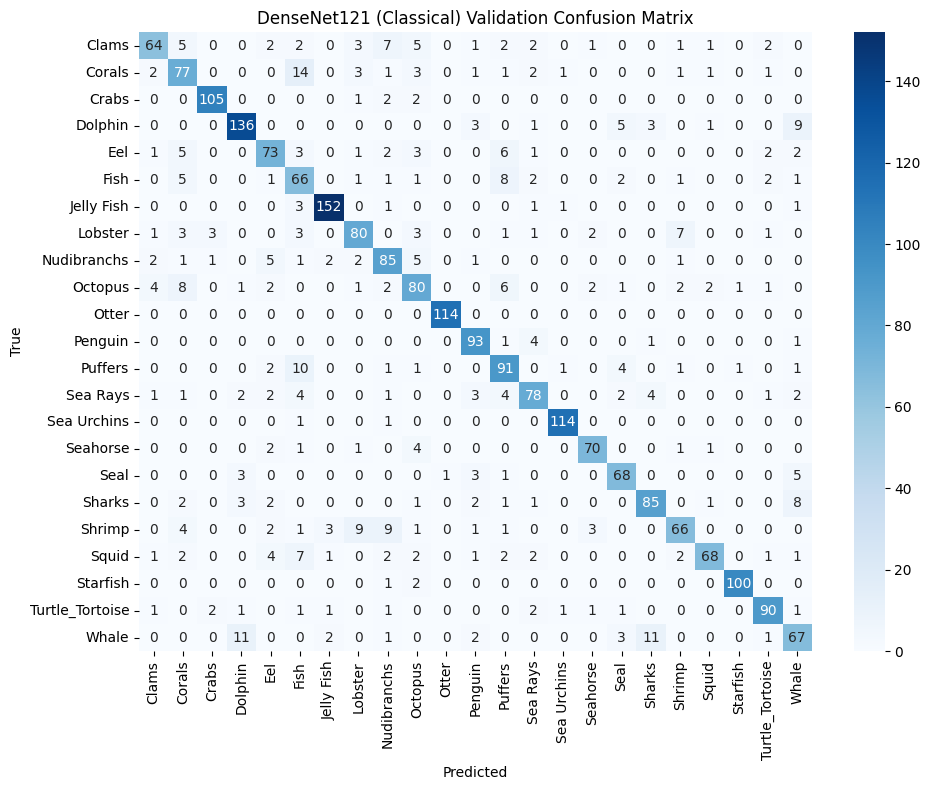


📊 Classification Report for DenseNet121 (Classical) Validation:

                 precision    recall  f1-score   support

          Clams       0.83      0.65      0.73        98
         Corals       0.68      0.71      0.70       108
          Crabs       0.95      0.95      0.95       110
        Dolphin       0.87      0.86      0.86       158
            Eel       0.75      0.74      0.74        99
           Fish       0.56      0.73      0.63        91
     Jelly Fish       0.94      0.96      0.95       159
        Lobster       0.78      0.76      0.77       105
    Nudibranchs       0.72      0.80      0.76       106
        Octopus       0.71      0.71      0.71       113
          Otter       0.99      1.00      1.00       114
        Penguin       0.84      0.93      0.88       100
        Puffers       0.73      0.81      0.76       113
       Sea Rays       0.80      0.74      0.77       105
    Sea Urchins       0.97      0.98      0.97       116
       Seahorse      

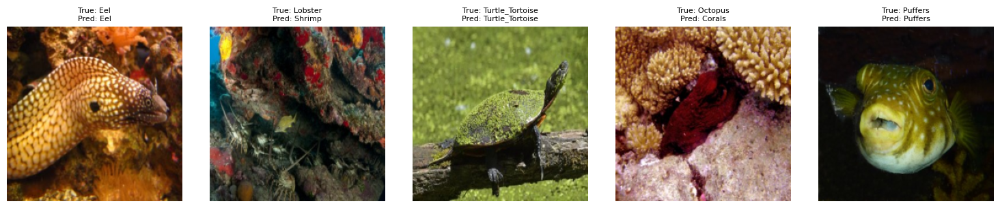


🔍 Testing started...
Using DataParallel for multi-GPU testing.

✅ Test Accuracy: 82.13%
📉 Test Loss: 0.8083

📊 Classification Report:

                 precision    recall  f1-score   support

          Clams       0.86      0.73      0.79       101
         Corals       0.64      0.83      0.72        92
          Crabs       0.91      0.96      0.93        90
        Dolphin       0.77      0.87      0.82       155
            Eel       0.72      0.68      0.70       100
           Fish       0.68      0.73      0.70       106
     Jelly Fish       0.94      0.93      0.94       179
        Lobster       0.83      0.80      0.81        95
    Nudibranchs       0.78      0.79      0.78        94
        Octopus       0.66      0.64      0.65       112
          Otter       0.99      1.00      0.99        86
        Penguin       0.86      0.87      0.87        93
        Puffers       0.68      0.85      0.76        99
       Sea Rays       0.76      0.79      0.78       102
    Sea 

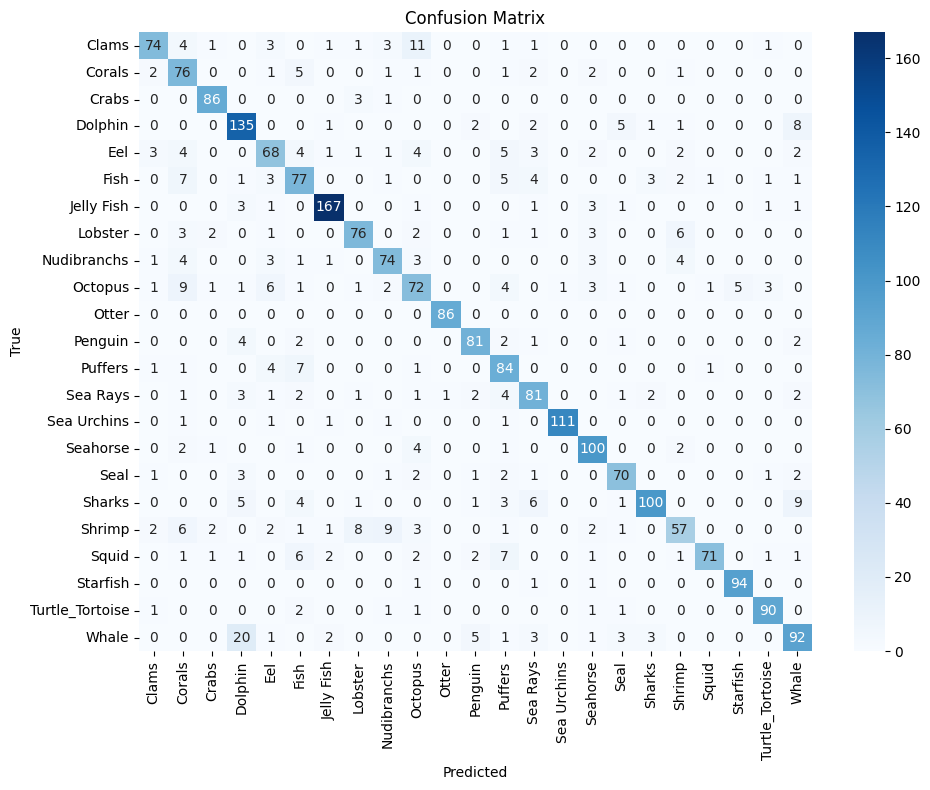

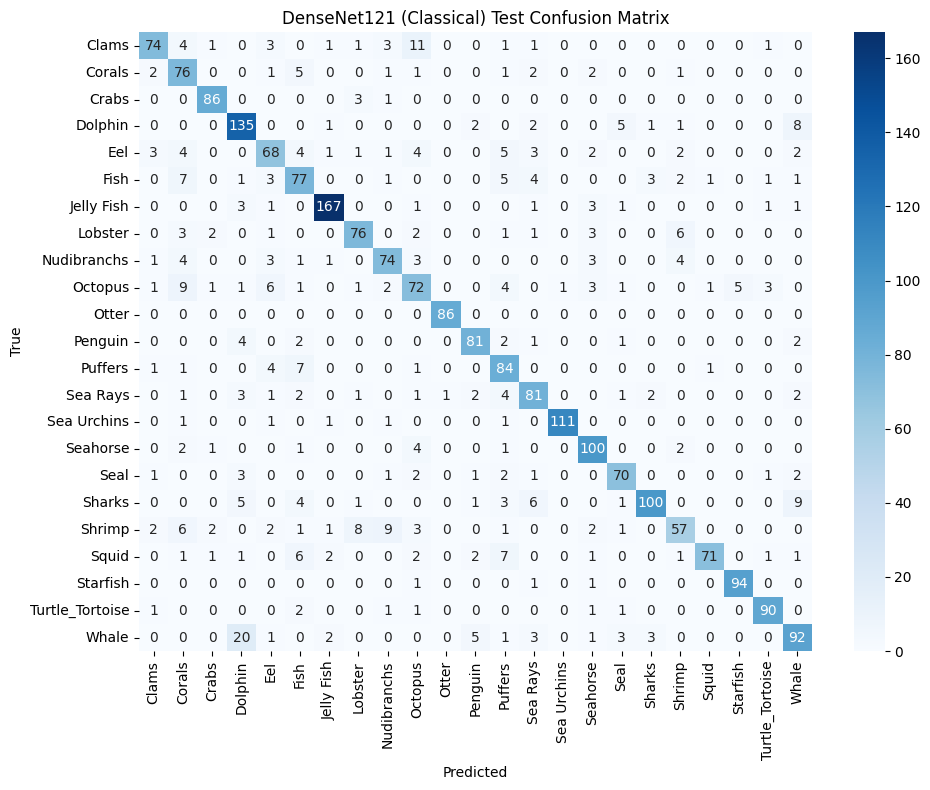


📊 Classification Report for DenseNet121 (Classical) Test:

                 precision    recall  f1-score   support

          Clams       0.86      0.73      0.79       101
         Corals       0.64      0.83      0.72        92
          Crabs       0.91      0.96      0.93        90
        Dolphin       0.77      0.87      0.82       155
            Eel       0.72      0.68      0.70       100
           Fish       0.68      0.73      0.70       106
     Jelly Fish       0.94      0.93      0.94       179
        Lobster       0.83      0.80      0.81        95
    Nudibranchs       0.78      0.79      0.78        94
        Octopus       0.66      0.64      0.65       112
          Otter       0.99      1.00      0.99        86
        Penguin       0.86      0.87      0.87        93
        Puffers       0.68      0.85      0.76        99
       Sea Rays       0.76      0.79      0.78       102
    Sea Urchins       0.99      0.96      0.97       116
       Seahorse       0.82 

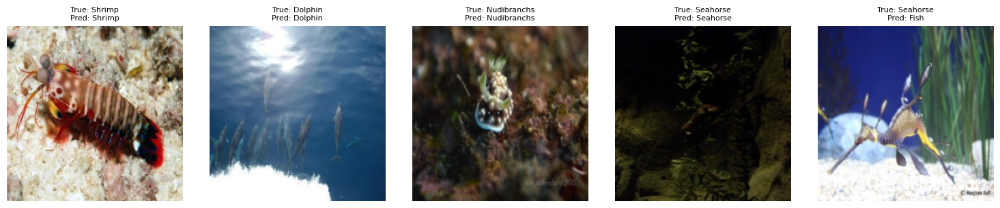

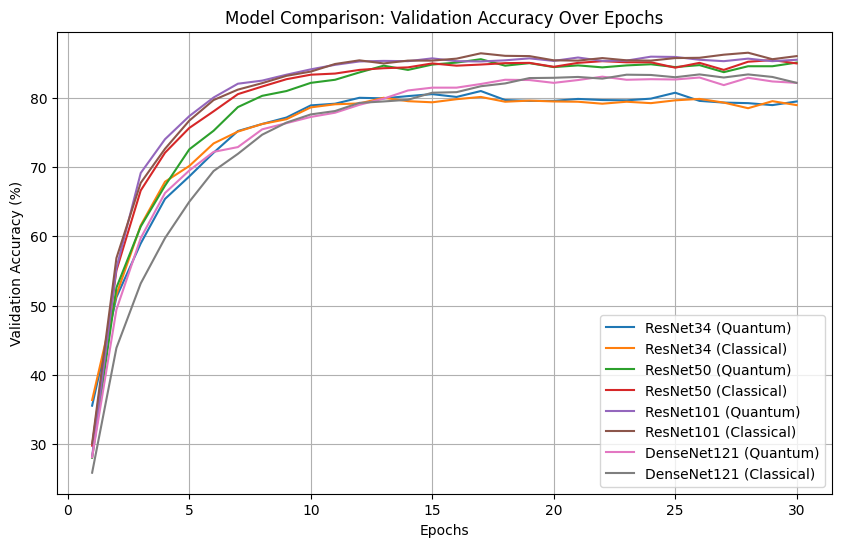


--- Test Accuracies ---
ResNet34 (Quantum): 79.41%
ResNet34 (Classical): 80.67%
ResNet50 (Quantum): 84.00%
ResNet50 (Classical): 84.40%
ResNet101 (Quantum): 86.39%
ResNet101 (Classical): 85.42%
DenseNet121 (Quantum): 82.17%
DenseNet121 (Classical): 82.13%


In [81]:
# === Main Function ===
def main():
    """
    Main function to run the training and testing of selected models.
    """

    all_model_accuracies = {}
    all_test_results = {}

    # Select models to run
    backbones = get_models(
        use_resnet34=True, use_resnet50=True, use_resnet101=True, use_densenet121=True
    )


    for model_name, backbone in backbones.items():
        print(f"\n--- Training and Testing {model_name} ---")

        model = (
            HybridQCNN(backbone, num_classes, n_qubits=N_QUBITS).to(device)
            if "Quantum" in model_name
            else ClassicalCNN(backbone, num_classes).to(device)
        )

        (
            train_losses,
            train_accs,
            val_losses,
            val_accs,
            val_preds,
            val_labels,
            val_images
        ) = train_model(model, train_loader, val_loader, num_classes)

        all_model_accuracies[model_name] = val_accs

        plot_metrics(train_losses, val_losses, train_accs, val_accs, model_name)
        plot_confusion_matrix(val_labels, val_preds, full_dataset.classes, f"{model_name} Validation")
        print_classification_report(
            val_labels, val_preds, full_dataset.classes, f"{model_name} Validation"
        )
        display_predictions(val_images, val_labels, val_preds, full_dataset.classes, num_display=5)


        test_preds, test_labels, test_acc, test_images = test_model(model, test_loader, full_dataset.classes)
        plot_confusion_matrix(
            test_labels,test_preds, full_dataset.classes, f"{model_name} Test"
        )
        print_classification_report(
            test_labels, test_preds, full_dataset.classes, f"{model_name} Test"
        )
        all_test_results[model_name] = test_acc
        display_predictions(test_images, test_labels, test_preds, full_dataset.classes, num_display=5)

    plot_model_comparison(all_model_accuracies)

    print("\n--- Test Accuracies ---")
    for model_name, test_acc in all_test_results.items():
        print(f"{model_name}: {test_acc:.2f}%")



if __name__ == "__main__":
    main()
